In [1]:
## import python modules
import numpy as np
import xarray as xr
import matplotlib
matplotlib.use("Agg")
import matplotlib.pyplot as plt
import glob
import pandas as pd

import cartopy
import cartopy.crs as ccrs
import matplotlib.ticker as mticker
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
from cartopy.util import add_cyclic_point
import matplotlib
import matplotlib.cm as cm
from matplotlib.colors import BoundaryNorm
import datetime as dt

#from matplotlib import animation
from matplotlib.animation import FuncAnimation
# from IPython.display import HTML
# import matplotlib.animation as animation

# from matplotlib import rc
import matplotlib
#plt.rcParams['animation.ffmpeg_path'] = '/usr/local/bin/ffmpeg'
%matplotlib inline
from PIL import Image, ImageDraw
from matplotlib import animation
from mpl_toolkits.axes_grid1 import make_axes_locatable
import math
import matplotlib.image as mgimg
from collections import Counter
from global_land_mask import globe
import scipy.optimize as opt
from sklearn.model_selection import train_test_split
from collections import Counter
from itertools import compress
from collections import OrderedDict

# Import Data in From Individual Graph Line

In [2]:
f = open("Buoy_Expanded_Non_Landfall_New.txt", "r") #unpack nonlandfalling internal and external
unpacker = np.loadtxt(f, unpack = True)
f_new = open("Buoy_Expanded_Non_Landfall_Ahead.txt", "r") #unpack nonlandfalling internal and ahead
unpackest = np.loadtxt(f_new, unpack = True)

f_name = open("Buoy_Expanded_Landfall_New.txt", "r") #unpack landfalling internal and external
unpack = np.loadtxt(f_name, unpack = True)
f_name_new = open("Buoy_Expanded_Landfall_Ahead.txt", "r") #unpack landfalling internal and ahead
unpackpack = np.loadtxt(f_name_new, unpack = True)

# Unpack and Clean Data, as Well as Create a Least Squares Fit

In [3]:
#Rsquared UDF: 
def Rsq_udf(x_data,y_data):
    
    """
    Calculates R^2 for a linear (deg = 1) fit to data (x_data, y_data)
    outputs R^2 value

    """


    #CALCULATE Y-fit AT THE EXACT SAME POINTS AS X-DATA (not for smooth curve plotting!!!!)
    deg = 1
    p_fit = np.polyfit(x_data,y_data,deg)
    y_fit = np.polyval(p_fit, x_data)
    
    
    #Best Fit Residual: 
    resid = (y_data-y_fit)
        #distances between data (y) and best fit estimates of y (y_fit)
    
    #MISFIT b/w Data and Best Fit: 
    misfit = np.sum(resid**2)
    #INTERNAL Residual (really spread) OF THE DATA ABOUT ITS OWN MEAN: 
    resid_internal = (y_data-np.mean(y_data))

    #INTERNAL MISFIT b/w the Data and its mean value ("internal" spread of the data): 
    misfit_internal = np.sum(resid_internal**2)
    #R-squared: the fractional difference between the internal misfit of the data 
    #and the best fit misfit: 
    Rsq = (misfit_internal-misfit)/misfit_internal
        #= 1 - misfit/misfit_internal
        #so  as misfit --> 0, R^2 goes to 1.  
        #and as misfit --> misfit_internal, R^2 --> 0 
    ########################################################################
    return Rsq

In [4]:
def fitter_udf(x_data,y_data):
    """
    Performs a simple linear fit

    """
    deg = 1
    p_fit = np.polyfit(x_data,y_data,deg)
    y_fit = np.polyval(p_fit, x_data)
    
    return p_fit, y_fit

In [5]:
def reject_outliers(data, m = 8): #so I can eliminate the massive outlying data, all values outside of 8 STD
    """
    Removes extreme outliers

    """
    d = np.abs(data - np.median(data))
    mdev = np.median(d)
    s = d/mdev if mdev else np.zeros(len(d))

    #indice_list = np.arange(0,len(data),1)
    mask = []
    data_arr = []
    for i in range(len(data)):
        if s[i] < m:
            data_arr.append(data[i])
            mask.append(i)
    return np.asarray(data_arr),mask

In [15]:
def cleaningudf(relation,data): #to remove any nan's and any large outliers
    """
    Removes the NaN's and outliers for data and from the respective choice of x axis

    """
    cleaner = [x for x in data if str(x) != 'nan']
    cleaned = relation[np.isnan(data)==False]
    cleanest,indice_list = reject_outliers(cleaner)
    cleaned_last=[]
    for i in indice_list:
        cleaned_last.append(cleaned[i])
    return np.asarray(cleaned_last),np.asarray(cleanest)

In [16]:
# def cleaningudf(relation,data): #to remove any nan's and any large outliers
#     """
#     Removes the NaN's and outliers for data and from the respective choice of x axis

#     """
#     cleaner = [x for x in data if str(x) != 'nan']
    
#     #clean_clean = [x for x in cleaner if abs(x) < np.max(psl_all)]
#     cleaned = relation[np.isnan(data)==False]
#     clean_clean = [x for x in cleaned if abs(x) < np.max(psl_all)]
#     cleanerest = []
#     for i in range(len(clean_clean)):
#         if clean_clean[i] < np.max(psl_all):
#             cleanerest.append(cleaner[i])

#     cleanest,indice_list = reject_outliers(cleanerest)
#     cleaned_last=[]
#     for i in indice_list:
#         cleaned_last.append(clean_clean[i])
#     return np.asarray(cleaned_last),np.asarray(cleanest)

In [17]:
internal = 1 #for internal values
offset = 5 #for external values
timeahead = 2 #how many timesteps ahead

psl_nlf = unpacker[1] #create array for pressure (for non_landfall)
wind_nlf = unpacker[2] #create array for wind (for non_landfall)
EQBL_nlf = unpacker[3] #creare array for EQBL (for non_landfall)
EQSLFT_nlf = unpacker[4] #create array for EQSLFT (for non_landfall)
EQULFT_nlf = unpacker[5] #create array for EQULFT (for non_landfall)
Subsat_nlf = unpacker[6] #create array for Subsaturation (for non_landfall)
CAPE_nlf = unpacker[7] #create array for CAPE (for non_landfall)
Buoy_nlf = unpacker[8] #create array for Buoyancy (for non_landfall)
precip_nlf = unpacker[9] #create array for precipitation (for non_landfall)

psl_lf = unpack[1] #create array for pressure (for landfall)
wind_lf = unpack[2] #create array for wind (for landfall)
EQBL_lf = unpack[3] #creare array for EQBL (for landfall)
EQSLFT_lf = unpack[4] #create array for EQSLFT (for landfall)
EQULFT_lf = unpack[5] #create array for EQULFT (for landfall)
Subsat_lf = unpack[6] #create array for Subsaturation (for landfall)
CAPE_lf = unpack[7] #create array for CAPE (for landfall)
Buoy_lf = unpack[8] #create array for Buoyancy (for andfall)
precip_lf = unpack[9] #create array for precipitation (for landfall)

psl_nlf_ahead = unpackest[1] #create array for pressure (for non_landfall ahead)
wind_nlf_ahead = unpackest[2] #create array for wind (for non_landfall ahead)
EQBL_nlf_ahead = unpackest[3] #creare array for EQBL (for non_landfall ahead)
EQSLFT_nlf_ahead = unpackest[4] #create array for EQSLFT (for non_landfall ahead)
EQULFT_nlf_ahead = unpackest[5] #create array for EQULFT (for non_landfall ahead)
Subsat_nlf_ahead = unpackest[6] #create array for Subsaturation (for non_landfall ahead)
CAPE_nlf_ahead = unpackest[7] #create array for CAPE (for non_landfall)
Buoy_nlf_ahead = unpackest[8] #create array for Buoyancy (for non_landfall ahead)
precip_nlf_ahead = unpackest[9] #create array for precipitation (for non_landfall ahead)

psl_lf_ahead = unpackpack[1] #create array for pressure (for landfall ahead)
wind_lf_ahead = unpackpack[2] #create array for wind (for landfall ahead)
EQBL_lf_ahead = unpackpack[3] #creare array for EQBL (for landfall ahead)
EQSLFT_lf_ahead = unpackpack[4] #create array for EQSLFT (for landfall ahead)
EQULFT_lf_ahead = unpackpack[5] #create array for EQULFT (for landfall ahead)
Subsat_lf_ahead = unpackpack[6] #create array for Subsaturation (for landfall ahead)
CAPE_lf_ahead = unpackpack[7] #create array for CAPE (for landfall ahead)
Buoy_lf_ahead = unpackpack[8] #create array for Buoyancy (for andfall ahead)
precip_lf_ahead = unpackpack[9] #create array for precipitation (for landfall ahead)


#joining landfalling and nonlandfalling

psl_all=np.append(psl_nlf,psl_lf) 
wind_all=np.append(wind_nlf,wind_lf)
EQBL_all=np.append(EQBL_nlf,EQBL_lf)
EQSLFT_all=np.append(EQSLFT_nlf,EQSLFT_lf)
EQULFT_all=np.append(EQULFT_nlf,EQULFT_lf)
Subsat_all=np.append(Subsat_nlf,Subsat_lf)
CAPE_all=np.append(CAPE_nlf,CAPE_lf)
Buoy_all=np.append(Buoy_nlf,Buoy_lf)
precip_all=np.append(precip_nlf,precip_lf)

psl_all_ahead=np.append(psl_nlf_ahead,psl_lf_ahead)
wind_all_ahead=np.append(wind_nlf_ahead,wind_lf_ahead)
EQBL_all_ahead=np.append(EQBL_nlf_ahead,EQBL_lf_ahead)
EQSLFT_all_ahead=np.append(EQSLFT_nlf_ahead,EQSLFT_lf_ahead)
EQULFT_all_ahead=np.append(EQULFT_nlf_ahead,EQULFT_lf_ahead)
Subsat_all_ahead=np.append(Subsat_nlf_ahead,Subsat_lf_ahead)
CAPE_all_ahead=np.append(CAPE_nlf_ahead,CAPE_lf_ahead)
Buoy_all_ahead=np.append(Buoy_nlf_ahead,Buoy_lf_ahead)
precip_all_ahead=np.append(precip_nlf_ahead,precip_lf_ahead)
           
#Cleans data for precipitation with respect to Subsaturation, CAPE, and Buoyancy

precip_nlf_Subsat, precip_Subsat_nlf = cleaningudf(Subsat_nlf,precip_nlf)
precip_nlf_CAPE, precip_CAPE_nlf = cleaningudf(CAPE_nlf,precip_nlf)
precip_lf_Subsat, precip_Subsat_lf = cleaningudf(Subsat_lf,precip_lf)
precip_lf_CAPE, precip_CAPE_lf = cleaningudf(CAPE_lf,precip_lf)
precip_all_Subsat, precip_Subsat_all = cleaningudf(Subsat_all,precip_all)
precip_all_CAPE, precip_CAPE_all = cleaningudf(CAPE_all,precip_all)
precip_nlf_Buoy, precip_Buoy_nlf = cleaningudf(Buoy_nlf,precip_nlf)
precip_lf_Buoy, precip_Buoy_lf = cleaningudf(Buoy_lf,precip_lf)
precip_all_Buoy, precip_Buoy_all = cleaningudf(Buoy_all,precip_all)

precip_nlf_Subsat_ahead, precip_Subsat_nlf_ahead = cleaningudf(Subsat_nlf_ahead,precip_nlf_ahead)
precip_nlf_CAPE_ahead, precip_CAPE_nlf_ahead = cleaningudf(CAPE_nlf_ahead,precip_nlf_ahead)
precip_lf_Subsat_ahead, precip_Subsat_lf_ahead = cleaningudf(Subsat_lf_ahead,precip_lf_ahead)
precip_lf_CAPE_ahead, precip_CAPE_lf_ahead = cleaningudf(CAPE_lf_ahead,precip_lf_ahead)
precip_all_Subsat_ahead, precip_Subsat_all_ahead = cleaningudf(Subsat_all_ahead,precip_all_ahead)
precip_all_CAPE_ahead, precip_CAPE_all_ahead = cleaningudf(CAPE_all_ahead,precip_all_ahead)
precip_nlf_Buoy_ahead, precip_Buoy_nlf_ahead = cleaningudf(Buoy_nlf_ahead,precip_nlf_ahead)
precip_lf_Buoy_ahead, precip_Buoy_lf_ahead = cleaningudf(Buoy_lf_ahead,precip_lf_ahead)
precip_all_Buoy_ahead, precip_Buoy_all_ahead = cleaningudf(Buoy_all_ahead,precip_all_ahead)


#cleaning all non-landfalling internal/external data
psl_nlf_EQBL, EQBL_nlf = cleaningudf(psl_nlf,EQBL_nlf)
psl_nlf_EQSLFT, EQSLFT_nlf = cleaningudf(psl_nlf,EQSLFT_nlf) 
psl_nlf_EQULFT, EQULFT_nlf = cleaningudf(psl_nlf,EQULFT_nlf) 
psl_nlf_Subsat, Subsat_nlf = cleaningudf(psl_nlf,Subsat_nlf)
psl_nlf_CAPE, CAPE_nlf = cleaningudf(psl_nlf,CAPE_nlf)
psl_nlf_Buoy, Buoy_nlf = cleaningudf(psl_nlf,Buoy_nlf)
psl_nlf_precip, precip_nlf = cleaningudf(psl_nlf,precip_nlf)

#cleaning all landfalling internal/external data
psl_lf_EQBL, EQBL_lf = cleaningudf(psl_lf,EQBL_lf)
psl_lf_EQSLFT, EQSLFT_lf = cleaningudf(psl_lf,EQSLFT_lf) 
psl_lf_EQULFT, EQULFT_lf = cleaningudf(psl_lf,EQULFT_lf) 
psl_lf_Subsat, Subsat_lf = cleaningudf(psl_lf,Subsat_lf)
psl_lf_CAPE, CAPE_lf = cleaningudf(psl_lf,CAPE_lf)
psl_lf_Buoy, Buoy_lf = cleaningudf(psl_lf,Buoy_lf)
psl_lf_precip, precip_lf = cleaningudf(psl_lf,precip_lf)

#cleaning all non-landfalling internal/ahead data
psl_nlf_EQBL_ahead, EQBL_nlf_ahead = cleaningudf(psl_nlf_ahead,EQBL_nlf_ahead)
psl_nlf_EQSLFT_ahead, EQSLFT_nlf_ahead = cleaningudf(psl_nlf_ahead,EQSLFT_nlf_ahead) 
psl_nlf_EQULFT_ahead, EQULFT_nlf_ahead = cleaningudf(psl_nlf_ahead,EQULFT_nlf_ahead) 
psl_nlf_Subsat_ahead, Subsat_nlf_ahead = cleaningudf(psl_nlf_ahead,Subsat_nlf_ahead)
psl_nlf_CAPE_ahead, CAPE_nlf_ahead = cleaningudf(psl_nlf_ahead,CAPE_nlf_ahead)
psl_nlf_Buoy_ahead, Buoy_nlf_ahead = cleaningudf(psl_nlf_ahead,Buoy_nlf_ahead)
psl_nlf_precip_ahead, precip_nlf_ahead = cleaningudf(psl_nlf_ahead,precip_nlf_ahead)

#cleaning all landfalling internal/ahead data
psl_lf_EQBL_ahead, EQBL_lf_ahead = cleaningudf(psl_lf_ahead,EQBL_lf_ahead)
psl_lf_EQSLFT_ahead, EQSLFT_lf_ahead = cleaningudf(psl_lf_ahead,EQSLFT_lf_ahead) 
psl_lf_EQULFT_ahead, EQULFT_lf_ahead = cleaningudf(psl_lf_ahead,EQULFT_lf_ahead) 
psl_lf_Subsat_ahead, Subsat_lf_ahead = cleaningudf(psl_lf_ahead,Subsat_lf_ahead)
psl_lf_CAPE_ahead, CAPE_lf_ahead = cleaningudf(psl_lf_ahead,CAPE_lf_ahead)
psl_lf_Buoy_ahead, Buoy_lf_ahead = cleaningudf(psl_lf_ahead,Buoy_lf_ahead)
psl_lf_precip_ahead, precip_lf_ahead = cleaningudf(psl_lf_ahead,precip_lf_ahead)

#Creating massive added arrays for internal/external
#different psl arrays due to unique calculations
psl_all_EQBL=np.append(psl_nlf_EQBL,psl_lf_EQBL) 
psl_all_EQSLFT=np.append(psl_nlf_EQSLFT,psl_lf_EQSLFT) 
psl_all_EQULFT=np.append(psl_nlf_EQULFT,psl_lf_EQULFT) 
psl_all_Subsat=np.append(psl_nlf_Subsat,psl_lf_Subsat) 
psl_all_CAPE=np.append(psl_nlf_CAPE,psl_lf_CAPE) 
psl_all_Buoy=np.append(psl_nlf_Buoy,psl_lf_Buoy)
psl_all_precip=np.append(psl_nlf_precip,psl_lf_precip) 
wind_all=np.append(wind_nlf,wind_lf)
EQBL_all=np.append(EQBL_nlf,EQBL_lf)
EQSLFT_all=np.append(EQSLFT_nlf,EQSLFT_lf)
EQULFT_all=np.append(EQULFT_nlf,EQULFT_lf)
Subsat_all=np.append(Subsat_nlf,Subsat_lf)
CAPE_all=np.append(CAPE_nlf,CAPE_lf)
Buoy_all=np.append(Buoy_nlf,Buoy_lf)
precip_all=np.append(precip_nlf,precip_lf)

#Creating massive added arrays for internal/ahead
#different psl arrays due to unique calculations            
psl_all_EQBL_ahead=np.append(psl_nlf_EQBL_ahead,psl_lf_EQBL_ahead) 
psl_all_EQSLFT_ahead=np.append(psl_nlf_EQSLFT_ahead,psl_lf_EQSLFT_ahead) 
psl_all_EQULFT_ahead=np.append(psl_nlf_EQULFT_ahead,psl_lf_EQULFT_ahead) 
psl_all_Subsat_ahead=np.append(psl_nlf_Subsat_ahead,psl_lf_Subsat_ahead) 
psl_all_CAPE_ahead=np.append(psl_nlf_CAPE_ahead,psl_lf_CAPE_ahead) 
psl_all_Buoy_ahead=np.append(psl_nlf_Buoy_ahead,psl_lf_Buoy_ahead)
psl_all_precip_ahead=np.append(psl_nlf_precip_ahead,psl_lf_precip_ahead)             
wind_all_ahead=np.append(wind_nlf_ahead,wind_lf_ahead)
EQBL_all_ahead=np.append(EQBL_nlf_ahead,EQBL_lf_ahead)
EQSLFT_all_ahead=np.append(EQSLFT_nlf_ahead,EQSLFT_lf_ahead)
EQULFT_all_ahead=np.append(EQULFT_nlf_ahead,EQULFT_lf_ahead)
Subsat_all_ahead=np.append(Subsat_nlf_ahead,Subsat_lf_ahead)
CAPE_all_ahead=np.append(CAPE_nlf_ahead,CAPE_lf_ahead)
Buoy_all_ahead=np.append(Buoy_nlf_ahead,Buoy_lf_ahead)
precip_all_ahead=np.append(precip_nlf_ahead,precip_lf_ahead)

#Calculating the fit and RSQ for nonlandfalling internal/external

EQBl_nlf_fit = fitter_udf(psl_nlf_EQBL,EQBL_nlf)
EQBl_nlf_rsq = Rsq_udf(psl_nlf_EQBL,EQBL_nlf)
EQSLFT_nlf_fit = fitter_udf(psl_nlf_EQSLFT,EQSLFT_nlf)
EQSLFT_nlf_rsq = Rsq_udf(psl_nlf_EQSLFT,EQSLFT_nlf)
EQULFT_nlf_fit = fitter_udf(psl_nlf_EQULFT,EQULFT_nlf)
EQULFT_nlf_rsq = Rsq_udf(psl_nlf_EQULFT,EQULFT_nlf)
Subsat_nlf_fit = fitter_udf(psl_nlf_Subsat,Subsat_nlf)
Subsat_nlf_rsq = Rsq_udf(psl_nlf_Subsat,Subsat_nlf)                              
CAPE_nlf_fit = fitter_udf(psl_nlf_CAPE,CAPE_nlf)
CAPE_nlf_rsq = Rsq_udf(psl_nlf_CAPE,CAPE_nlf)           
Buoy_nlf_fit = fitter_udf(psl_nlf_Buoy,Buoy_nlf)
Buoy_nlf_rsq = Rsq_udf(psl_nlf_Buoy,Buoy_nlf)
precip_nlf_fit = fitter_udf(psl_nlf_precip,precip_nlf)
precip_nlf_rsq = Rsq_udf(psl_nlf_precip,precip_nlf)
wind_nlf_fit = fitter_udf(psl_nlf,wind_nlf)
wind_nlf_rsq = Rsq_udf(psl_nlf,wind_nlf)

#Calculating the fit and RSQ for landfalling internal/external            
                  
EQBl_lf_fit = fitter_udf(psl_lf_EQBL,EQBL_lf)
EQBl_lf_rsq = Rsq_udf(psl_lf_EQBL,EQBL_lf)
EQSLFT_lf_fit = fitter_udf(psl_lf_EQSLFT,EQSLFT_lf)
EQSLFT_lf_rsq = Rsq_udf(psl_lf_EQSLFT,EQSLFT_lf)
EQULFT_lf_fit = fitter_udf(psl_lf_EQULFT,EQULFT_lf)
EQULFT_lf_rsq = Rsq_udf(psl_lf_EQULFT,EQULFT_lf)
Subsat_lf_fit = fitter_udf(psl_lf_Subsat,Subsat_lf)
Subsat_lf_rsq = Rsq_udf(psl_lf_Subsat,Subsat_lf)                              
CAPE_lf_fit = fitter_udf(psl_lf_CAPE,CAPE_lf)
CAPE_lf_rsq = Rsq_udf(psl_lf_CAPE,CAPE_lf)           
Buoy_lf_fit = fitter_udf(psl_lf_Buoy,Buoy_lf)
Buoy_lf_rsq = Rsq_udf(psl_lf_Buoy,Buoy_lf)
precip_lf_fit = fitter_udf(psl_lf_precip,precip_lf)
precip_lf_rsq = Rsq_udf(psl_lf_precip,precip_lf)
wind_lf_fit = fitter_udf(psl_lf,wind_lf)
wind_lf_rsq = Rsq_udf(psl_lf,wind_lf)
                  
#Calculating the fit and RSQ for all internal/external            
                  
EQBl_all_fit = fitter_udf(psl_all_EQBL,EQBL_all)
EQBl_all_rsq = Rsq_udf(psl_all_EQBL,EQBL_all)
EQSLFT_all_fit = fitter_udf(psl_all_EQSLFT,EQSLFT_all)
EQSLFT_all_rsq = Rsq_udf(psl_all_EQSLFT,EQSLFT_all)
EQULFT_all_fit = fitter_udf(psl_all_EQULFT,EQULFT_all)
EQULFT_all_rsq = Rsq_udf(psl_all_EQULFT,EQULFT_all)
Subsat_all_fit = fitter_udf(psl_all_Subsat,Subsat_all)
Subsat_all_rsq = Rsq_udf(psl_all_Subsat,Subsat_all)                              
CAPE_all_fit = fitter_udf(psl_all_CAPE,CAPE_all)
CAPE_all_rsq = Rsq_udf(psl_all_CAPE,CAPE_all)           
Buoy_all_fit = fitter_udf(psl_all_Buoy,Buoy_all)
Buoy_all_rsq = Rsq_udf(psl_all_Buoy,Buoy_all)
precip_all_fit = fitter_udf(psl_all_precip,precip_all)
precip_all_rsq = Rsq_udf(psl_all_precip,precip_all)
wind_all_fit = fitter_udf(psl_all,wind_all)
wind_all_rsq = Rsq_udf(psl_all,wind_all)    
                  
#Calculating the fit and RSQ for nonlandfalling internal/ahead 
             
EQBl_nlf_fit_ahead = fitter_udf(psl_nlf_EQBL_ahead,EQBL_nlf_ahead)
EQBl_nlf_rsq_ahead = Rsq_udf(psl_nlf_EQBL_ahead,EQBL_nlf_ahead)
EQSLFT_nlf_fit_ahead = fitter_udf(psl_nlf_EQSLFT_ahead,EQSLFT_nlf_ahead)
EQSLFT_nlf_rsq_ahead = Rsq_udf(psl_nlf_EQSLFT_ahead,EQSLFT_nlf_ahead)
EQULFT_nlf_fit_ahead = fitter_udf(psl_nlf_EQULFT_ahead,EQULFT_nlf_ahead)
EQULFT_nlf_rsq_ahead = Rsq_udf(psl_nlf_EQULFT_ahead,EQULFT_nlf_ahead)
Subsat_nlf_fit_ahead = fitter_udf(psl_nlf_Subsat_ahead,Subsat_nlf_ahead)
Subsat_nlf_rsq_ahead = Rsq_udf(psl_nlf_Subsat_ahead,Subsat_nlf_ahead)                              
CAPE_nlf_fit_ahead = fitter_udf(psl_nlf_CAPE_ahead,CAPE_nlf_ahead)
CAPE_nlf_rsq_ahead = Rsq_udf(psl_nlf_CAPE_ahead,CAPE_nlf_ahead)           
Buoy_nlf_fit_ahead = fitter_udf(psl_nlf_Buoy_ahead,Buoy_nlf_ahead)
Buoy_nlf_rsq_ahead = Rsq_udf(psl_nlf_Buoy_ahead,Buoy_nlf_ahead)
precip_nlf_fit_ahead = fitter_udf(psl_nlf_precip_ahead,precip_nlf_ahead)
precip_nlf_rsq_ahead = Rsq_udf(psl_nlf_precip_ahead,precip_nlf_ahead)
wind_nlf_fit_ahead = fitter_udf(psl_nlf_ahead,wind_nlf_ahead)
wind_nlf_rsq_ahead = Rsq_udf(psl_nlf_ahead,wind_nlf_ahead)                  
                  
#Calculating the fit and RSQ for landfalling internal/ahead 
  
EQBl_lf_fit_ahead = fitter_udf(psl_lf_EQBL_ahead,EQBL_lf_ahead)
EQBl_lf_rsq_ahead = Rsq_udf(psl_lf_EQBL_ahead,EQBL_lf_ahead)
EQSLFT_lf_fit_ahead = fitter_udf(psl_lf_EQSLFT_ahead,EQSLFT_lf_ahead)
EQSLFT_lf_rsq_ahead = Rsq_udf(psl_lf_EQSLFT_ahead,EQSLFT_lf_ahead)
EQULFT_lf_fit_ahead = fitter_udf(psl_lf_EQULFT_ahead,EQULFT_lf_ahead)
EQULFT_lf_rsq_ahead = Rsq_udf(psl_lf_EQULFT_ahead,EQULFT_lf_ahead)
Subsat_lf_fit_ahead = fitter_udf(psl_lf_Subsat_ahead,Subsat_lf_ahead)
Subsat_lf_rsq_ahead = Rsq_udf(psl_lf_Subsat_ahead,Subsat_lf_ahead)                              
CAPE_lf_fit_ahead = fitter_udf(psl_lf_CAPE_ahead,CAPE_lf_ahead)
CAPE_lf_rsq_ahead = Rsq_udf(psl_lf_CAPE_ahead,CAPE_lf_ahead)           
Buoy_lf_fit_ahead = fitter_udf(psl_lf_Buoy_ahead,Buoy_lf_ahead)
Buoy_lf_rsq_ahead = Rsq_udf(psl_lf_Buoy_ahead,Buoy_lf_ahead)
precip_lf_fit_ahead = fitter_udf(psl_lf_precip_ahead,precip_lf_ahead)
precip_lf_rsq_ahead = Rsq_udf(psl_lf_precip_ahead,precip_lf_ahead)
wind_lf_fit_ahead = fitter_udf(psl_lf_ahead,wind_lf_ahead)
wind_lf_rsq_ahead = Rsq_udf(psl_lf_ahead,wind_lf_ahead)
                  
#Calculating the fit and RSQ for all internal/ahead 

EQBl_all_fit_ahead = fitter_udf(psl_all_EQBL_ahead,EQBL_all_ahead)
EQBl_all_rsq_ahead = Rsq_udf(psl_all_EQBL_ahead,EQBL_all_ahead)
EQSLFT_all_fit_ahead = fitter_udf(psl_all_EQSLFT_ahead,EQSLFT_all_ahead)
EQSLFT_all_rsq_ahead = Rsq_udf(psl_all_EQSLFT_ahead,EQSLFT_all_ahead)
EQULFT_all_fit_ahead = fitter_udf(psl_all_EQULFT_ahead,EQULFT_all_ahead)
EQULFT_all_rsq_ahead = Rsq_udf(psl_all_EQULFT_ahead,EQULFT_all_ahead)
Subsat_all_fit_ahead = fitter_udf(psl_all_Subsat_ahead,Subsat_all_ahead)
Subsat_all_rsq_ahead = Rsq_udf(psl_all_Subsat_ahead,Subsat_all_ahead)                              
CAPE_all_fit_ahead = fitter_udf(psl_all_CAPE_ahead,CAPE_all_ahead)
CAPE_all_rsq_ahead = Rsq_udf(psl_all_CAPE_ahead,CAPE_all_ahead)           
Buoy_all_fit_ahead = fitter_udf(psl_all_Buoy_ahead,Buoy_all_ahead)
Buoy_all_rsq_ahead = Rsq_udf(psl_all_Buoy_ahead,Buoy_all_ahead)
precip_all_fit_ahead = fitter_udf(psl_all_precip_ahead,precip_all_ahead)
precip_all_rsq_ahead = Rsq_udf(psl_all_precip_ahead,precip_all_ahead)
wind_all_fit_ahead = fitter_udf(psl_all_ahead,wind_all_ahead)
wind_all_rsq_ahead = Rsq_udf(psl_all_ahead,wind_all_ahead)  





# Plot Non-Landfalling Internal Minus External Values

/tmp/ipykernel_300559/2250376880.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


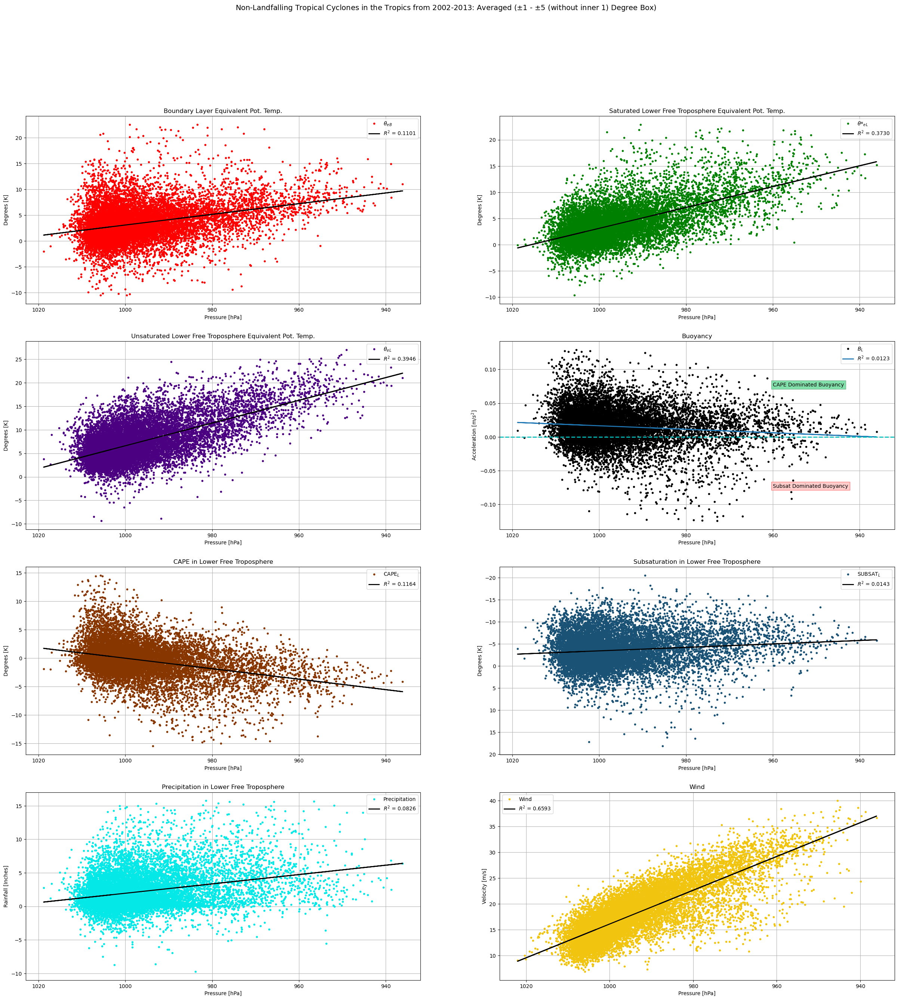

In [220]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_nlf_EQBL,EQBL_nlf, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_nlf_EQBL,EQBl_nlf_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_nlf_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_nlf_EQSLFT,EQSLFT_nlf, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_nlf_EQSLFT,EQSLFT_nlf_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_nlf_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_nlf_EQULFT,EQULFT_nlf, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_nlf_EQULFT,EQULFT_nlf_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_nlf_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_nlf_Buoy,Buoy_nlf, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_nlf_Buoy,Buoy_nlf_fit[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_nlf_rsq))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_nlf_CAPE,CAPE_nlf, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_nlf_CAPE,CAPE_nlf_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_nlf_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_nlf_Subsat,Subsat_nlf, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_nlf_Subsat,Subsat_nlf_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_nlf_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_nlf_precip,precip_nlf, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_nlf_precip,precip_nlf_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_nlf_rsq))

plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_nlf,wind_nlf, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_nlf,wind_nlf_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_nlf_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('Non-Landfalling Tropical Cyclones in the Tropics from 2002-2013: Averaged ($\u00B1${} - $\u00B1${} (without inner {}) Degree Box)'.format(internal,offset,internal),fontsize=14);


# Plot Landfalling Internal Minus External Values

/tmp/ipykernel_300559/2091580046.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


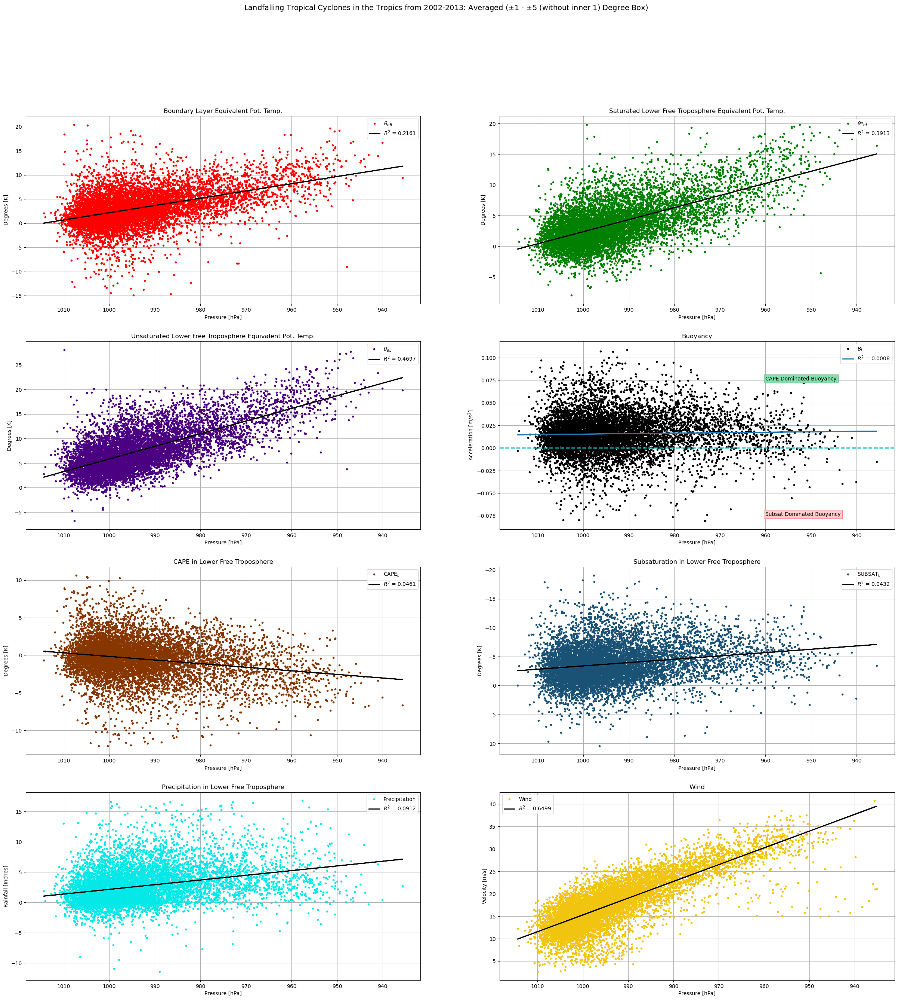

In [59]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_lf_EQBL,EQBL_lf, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_lf_EQBL,EQBl_lf_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_lf_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_lf_EQSLFT,EQSLFT_lf, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_lf_EQSLFT,EQSLFT_lf_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_lf_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_lf_EQULFT,EQULFT_lf, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_lf_EQULFT,EQULFT_lf_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_lf_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_lf_Buoy,Buoy_lf, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_lf_Buoy,Buoy_lf_fit[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_lf_rsq))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_lf_CAPE,CAPE_lf, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_lf_CAPE,CAPE_lf_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_lf_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_lf_Subsat,Subsat_lf, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_lf_Subsat,Subsat_lf_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_lf_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_lf_precip,precip_lf, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_lf_precip,precip_lf_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_lf_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_lf,wind_lf, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_lf,wind_lf_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_lf_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('Landfalling Tropical Cyclones in the Tropics from 2002-2013: Averaged ($\u00B1${} - $\u00B1${} (without inner {}) Degree Box)'.format(internal,offset,internal),fontsize=14);


# Plot All Internal Minus External Values

/tmp/ipykernel_300559/2843159807.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


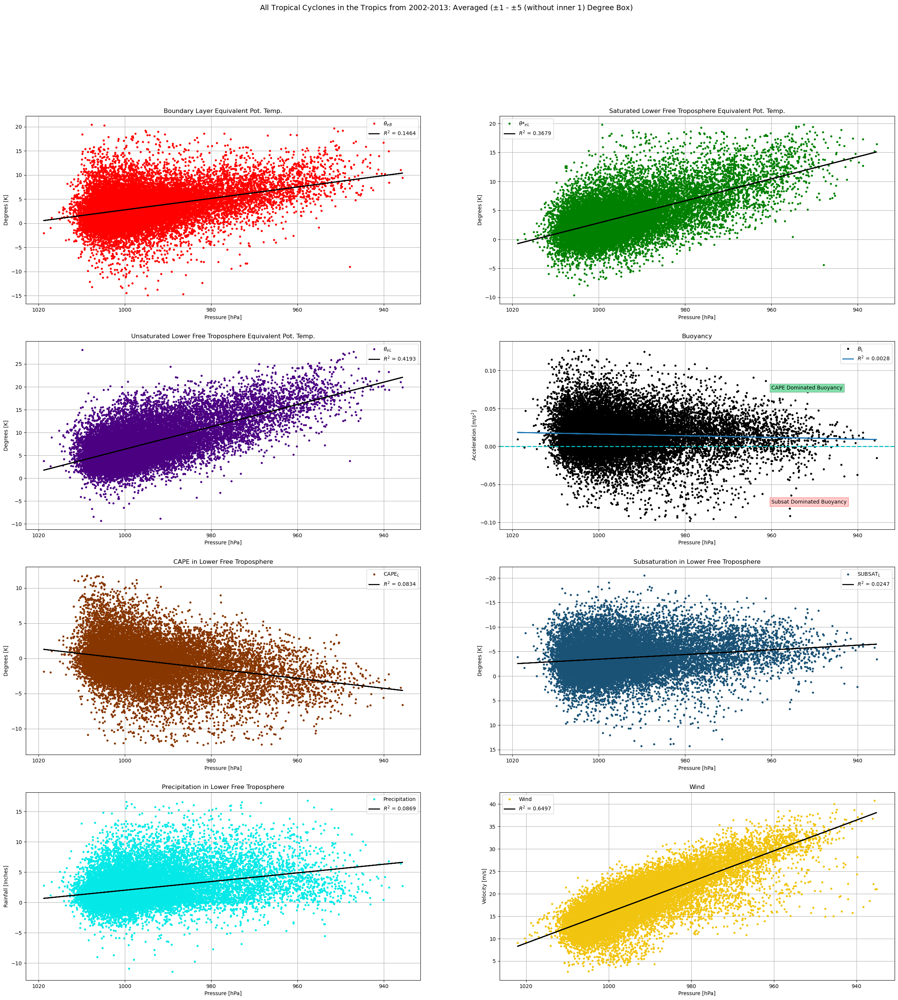

In [215]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_all_EQBL,EQBL_all, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_all_EQBL,EQBl_all_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_all_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_all_EQSLFT,EQSLFT_all, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_all_EQSLFT,EQSLFT_all_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_all_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_all_EQULFT,EQULFT_all, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_all_EQULFT,EQULFT_all_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_all_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_all_Buoy,Buoy_all, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_all_Buoy,Buoy_all_fit[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_all_rsq))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_all_CAPE,CAPE_all, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_all_CAPE,CAPE_all_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_all_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_all_Subsat,Subsat_all, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_all_Subsat,Subsat_all_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_all_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_all_precip,precip_all, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_all_precip,precip_all_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_all_rsq))

plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_all,wind_all, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_all,wind_all_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_all_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('All Tropical Cyclones in the Tropics from 2002-2013: Averaged ($\u00B1${} - $\u00B1${} (without inner {}) Degree Box)'.format(internal,offset,internal),fontsize=14);


# Plot Non-Landfalling Internal - (Insert) Timesteps Ahead Values

/tmp/ipykernel_300559/4064431051.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


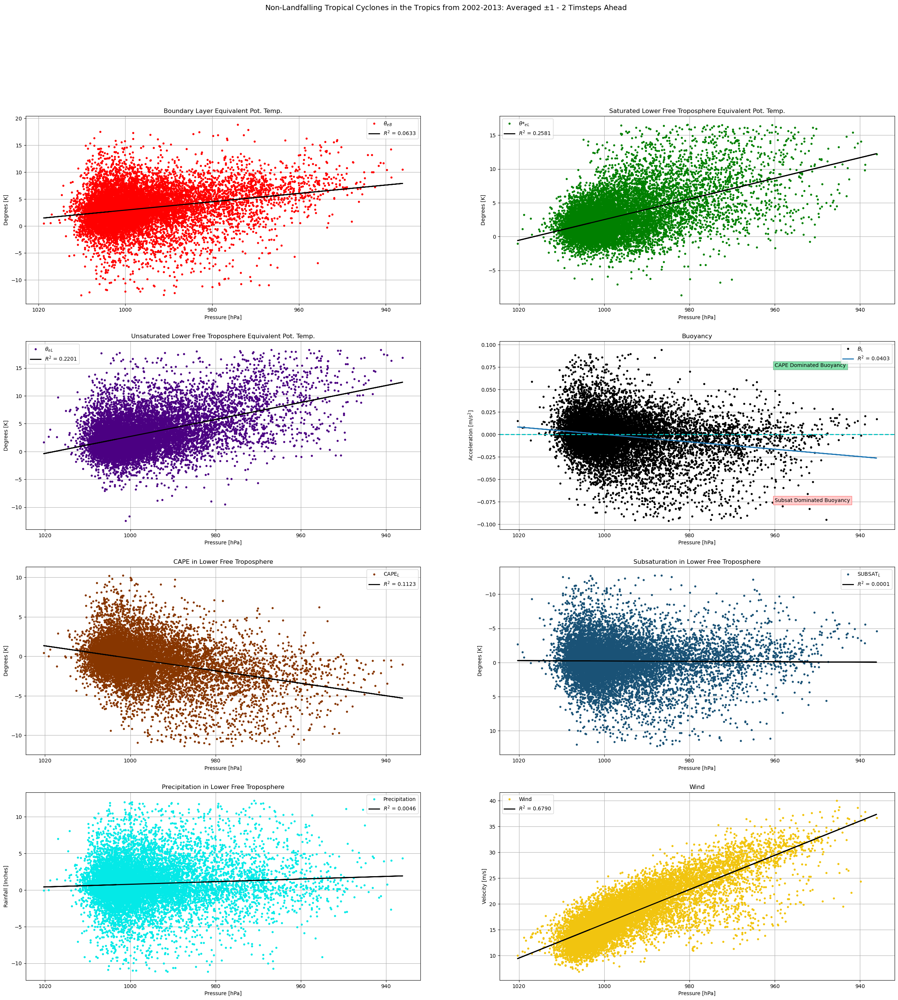

In [61]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_nlf_EQBL_ahead,EQBL_nlf_ahead, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_nlf_EQBL_ahead,EQBl_nlf_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_nlf_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_nlf_EQSLFT_ahead,EQSLFT_nlf_ahead, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_nlf_EQSLFT_ahead,EQSLFT_nlf_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_nlf_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_nlf_EQULFT_ahead,EQULFT_nlf_ahead, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_nlf_EQULFT_ahead,EQULFT_nlf_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_nlf_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_nlf_Buoy_ahead,Buoy_nlf_ahead, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_nlf_Buoy_ahead,Buoy_nlf_fit_ahead[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_nlf_rsq_ahead))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_nlf_CAPE_ahead,CAPE_nlf_ahead, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_nlf_CAPE_ahead,CAPE_nlf_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_nlf_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_nlf_Subsat_ahead,Subsat_nlf_ahead, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_nlf_Subsat_ahead,Subsat_nlf_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_nlf_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_nlf_precip_ahead,precip_nlf_ahead, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_nlf_precip_ahead,precip_nlf_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_nlf_rsq_ahead))

plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_nlf_ahead,wind_nlf_ahead, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_nlf_ahead,wind_nlf_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_nlf_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('Non-Landfalling Tropical Cyclones in the Tropics from 2002-2013: Averaged $\u00B1${} - {} Timsteps Ahead'.format(internal,timeahead),fontsize=14);


# Plot Landfalling Internal - (Insert) Timesteps Ahead Values

/tmp/ipykernel_300559/1159842250.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


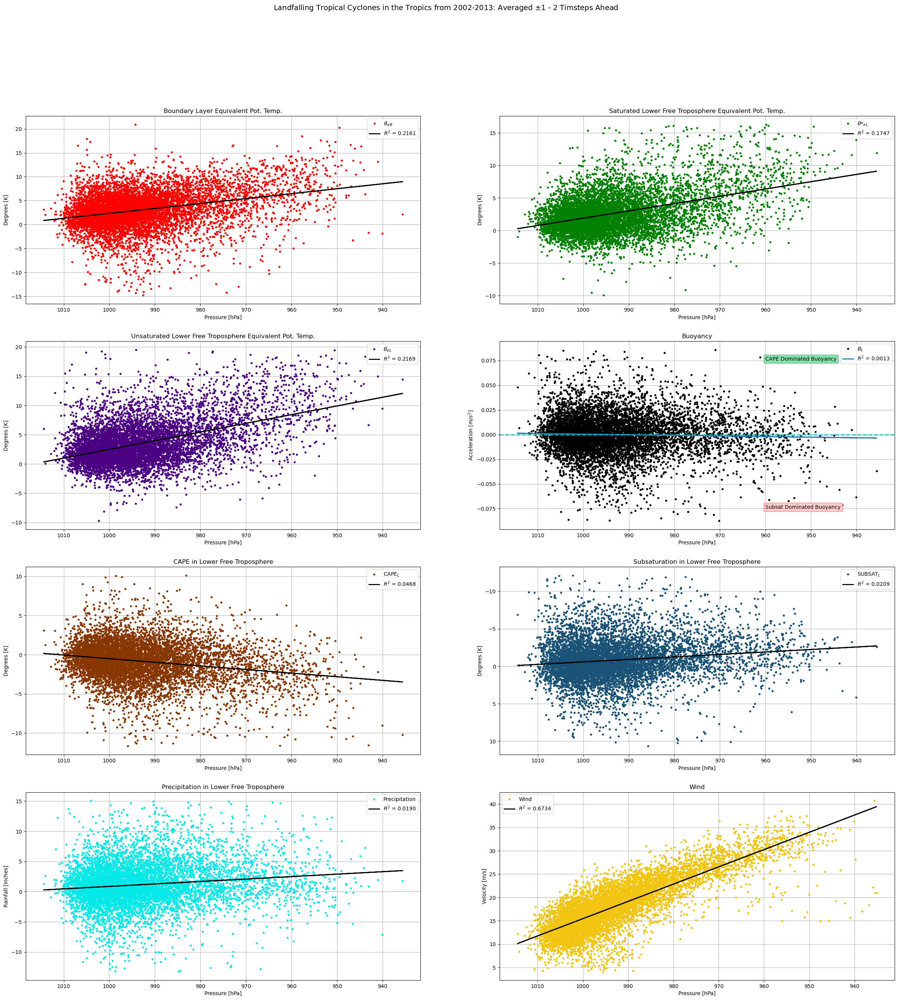

In [62]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_lf_EQBL_ahead,EQBL_lf_ahead, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_lf_EQBL_ahead,EQBl_lf_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_lf_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_lf_EQSLFT_ahead,EQSLFT_lf_ahead, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_lf_EQSLFT_ahead,EQSLFT_lf_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_lf_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_lf_EQULFT_ahead,EQULFT_lf_ahead, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_lf_EQULFT_ahead,EQULFT_lf_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_lf_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_lf_Buoy_ahead,Buoy_lf_ahead, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_lf_Buoy_ahead,Buoy_lf_fit_ahead[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_lf_rsq_ahead))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_lf_CAPE_ahead,CAPE_lf_ahead, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_lf_CAPE_ahead,CAPE_lf_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_lf_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_lf_Subsat_ahead,Subsat_lf_ahead, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_lf_Subsat_ahead,Subsat_lf_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_lf_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_lf_precip_ahead,precip_lf_ahead, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_lf_precip_ahead,precip_lf_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_lf_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_lf_ahead,wind_lf_ahead, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_lf_ahead,wind_lf_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_lf_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('Landfalling Tropical Cyclones in the Tropics from 2002-2013: Averaged $\u00B1${} - {} Timsteps Ahead'.format(internal,timeahead),fontsize=14);



# Plot All Internal - (Insert) Timesteps Ahead Values

/tmp/ipykernel_300559/81538720.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


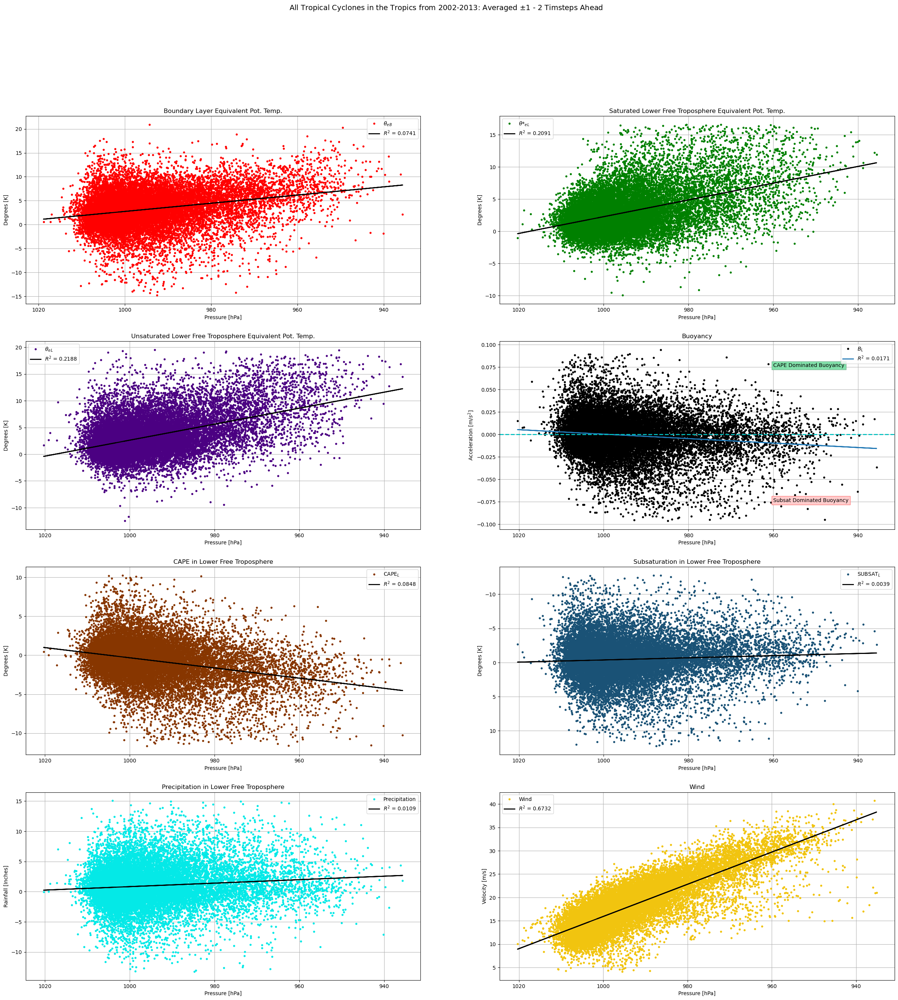

In [63]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_all_EQBL_ahead,EQBL_all_ahead, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_all_EQBL_ahead,EQBl_all_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_all_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_all_EQSLFT_ahead,EQSLFT_all_ahead, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_all_EQSLFT_ahead,EQSLFT_all_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_all_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_all_EQULFT_ahead,EQULFT_all_ahead, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_all_EQULFT_ahead,EQULFT_all_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_all_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_all_Buoy_ahead,Buoy_all_ahead, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_all_Buoy_ahead,Buoy_all_fit_ahead[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_all_rsq_ahead))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_all_CAPE_ahead,CAPE_all_ahead, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_all_CAPE_ahead,CAPE_all_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_all_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_all_Subsat_ahead,Subsat_all_ahead, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_all_Subsat_ahead,Subsat_all_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_all_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_all_precip_ahead,precip_all_ahead, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_all_precip_ahead,precip_all_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_all_rsq_ahead))

plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_all_ahead,wind_all_ahead, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_all_ahead,wind_all_fit_ahead[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_all_rsq_ahead))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('All Tropical Cyclones in the Tropics from 2002-2013: Averaged $\u00B1${} - {} Timsteps Ahead'.format(internal,timeahead),fontsize=14);



# Binning UDF

In [8]:
def bin_buoyancy(binner,tobin,buoy_ins):
    """
    Takes the binned average of tobin with respect to binner's buoy_ins

    """
    x,y = binner,tobin
    
    y=y[np.isfinite(x)]
    x=x[np.isfinite(x)]
    
    buoy_indx=np.int_((x-buoy_ins[0])/np.diff(buoy_ins)[0])
    #print(buoy_indx)
    buoydex=5*buoy_indx+945
    tt=Counter(buoydex)
    t = tt.most_common()
    t=sorted(t)
    #print(t)

    buoy_hist=np.zeros_like(buoy_ins)
    buoy_std= []
    prc_binned= []
    
    for i in np.arange(buoy_ins.size):
        indx=np.where(buoy_indx==i)
        #print(indx)
        buoy_hist[i]=indx[0].size
        prc=y[indx].mean()
        prc_binned.append(prc)
        buoy_st=y[indx].std()/np.sqrt(buoy_hist[i])
        buoy_std.append(buoy_st)
        buoy_hist=buoy_hist/(buoy_hist.sum()*np.diff(buoy_ins)[0])
    return prc_binned,buoy_std,buoy_hist

start = 945 #for PSL range
stop = 1015 #for PSL range
spacing = 5 #range of each bin
buoy_bins=np.arange(start,stop,spacing)
buoy_new_bins=np.arange(-0.125,.125,0.0125) #for binning with respect to buoyancy
variable="CAPE"
#Variable choices include:
#EQBL
#EQSLFT
#EQULFT
#Subsaturation
#CAPE
#Buoyancy
#Precipitation

# Plot the Internal-External Bins with Variable Choice

/tmp/ipykernel_300559/1061036734.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2,2,1) #For NLF


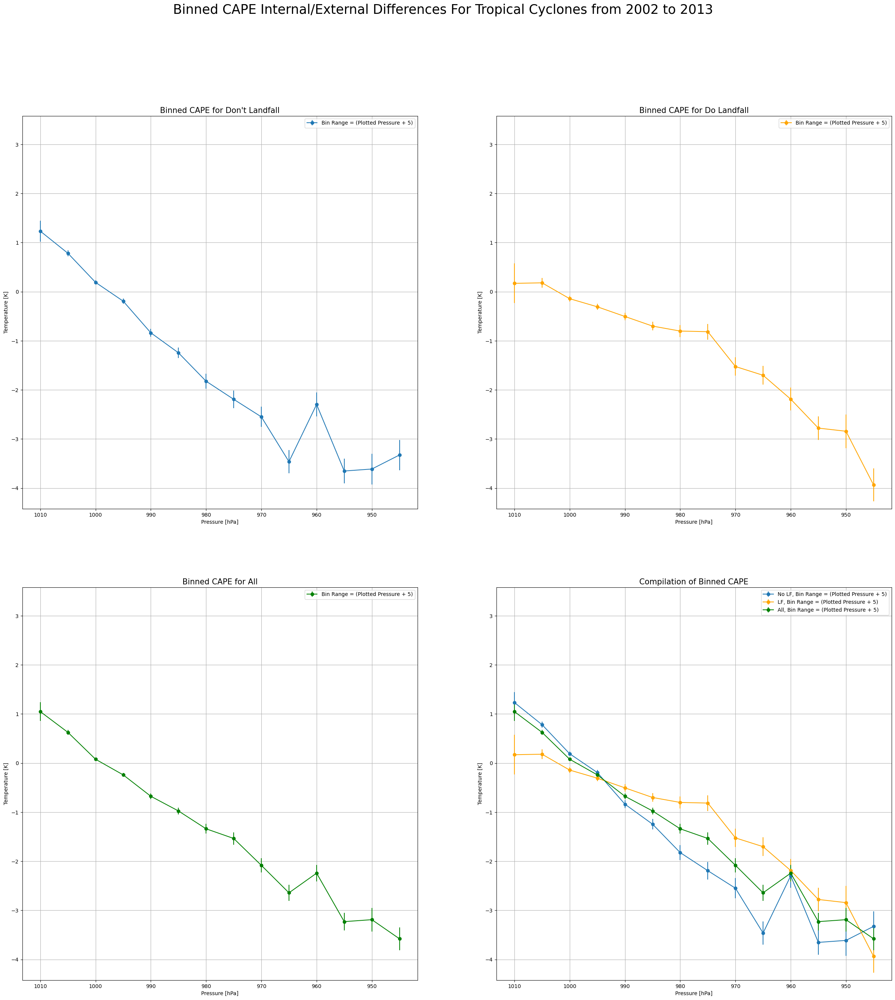

In [276]:
plt.subplots(figsize = (30,30))
plt.subplot(2,2,1) #For NLF
if variable == "EQBL":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(psl_nlf_EQBL,EQBL_nlf,buoy_bins) #take bins
    minn=np.average(EQBL_all)-20
    maxx=np.average(EQBL_all)+20
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(psl_nlf_EQSLFT,EQSLFT_nlf,buoy_bins) #take bins
    minn=np.average(EQSLFT_all)-20
    maxx=np.average(EQSLFT_all)+20
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(psl_nlf_EQULFT,EQULFT_nlf,buoy_bins) #take bins
    minn=np.average(EQULFT_all)-20
    maxx=np.average(EQULFT_all)+20
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)  
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(psl_nlf_Subsat,Subsat_nlf,buoy_bins) #take bins
    minn=np.average(Subsat_all)-4
    maxx=np.average(Subsat_all)+4
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(psl_nlf_CAPE,CAPE_nlf,buoy_bins) #take bins
    minn=np.average(CAPE_all)-4
    maxx=np.average(CAPE_all)+4
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(psl_nlf_Buoy,Buoy_nlf,buoy_bins) #take bins
    minn=np.average(Buoy_all)-.05
    maxx=np.average(Buoy_all)+.05
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(psl_nlf_precip,precip_nlf,buoy_bins) #take bins
    minn=np.average(precip_all)-2
    maxx=np.average(precip_all)+2
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);   
    
    
plt.errorbar(buoy_bins,nlf_psl_means,nlf_err,color='#1f77b4',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))

plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
plt.title("Binned {} for Don't Landfall".format(variable),fontsize=15)


plt.subplot(2,2,2) #For LF
if variable == "EQBL":
    lf_psl_means, lf_err,lf_his = bin_buoyancy(psl_lf_EQBL,EQBL_lf,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(psl_lf_EQSLFT,EQSLFT_lf,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(psl_lf_EQULFT,EQULFT_lf,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(psl_lf_Subsat,Subsat_lf,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(psl_lf_CAPE,CAPE_lf,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(psl_lf_Buoy,Buoy_lf,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(psl_lf_precip,precip_lf,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10); 
    
plt.errorbar(buoy_bins,lf_psl_means,lf_err,color='orange',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
plt.title("Binned {} for Do Landfall".format(variable),fontsize=15)


plt.subplot(2,2,3) #For All
if variable == "EQBL":
    all_psl_means, all_err,all_his = bin_buoyancy(psl_all_EQBL,EQBL_all,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    all_psl_means, all_err,all_his = bin_buoyancy(psl_all_EQSLFT,EQSLFT_all,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    all_psl_means, all_err, all_his = bin_buoyancy(psl_all_EQULFT,EQULFT_all,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    all_psl_means, all_err, all_his = bin_buoyancy(psl_all_Subsat,Subsat_all,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    all_psl_means, all_err, all_his = bin_buoyancy(psl_all_CAPE,CAPE_all,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    all_psl_means, all_err, all_his = bin_buoyancy(psl_all_Buoy,Buoy_all,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    all_psl_means, all_err, all_his = bin_buoyancy(psl_all_precip,precip_all,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10); 

plt.errorbar(buoy_bins,all_psl_means,all_err,color='g',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()    
plt.title("Binned {} for All".format(variable),fontsize=15)


plt.subplot(2,2,4) #For all 3
plt.errorbar(buoy_bins,nlf_psl_means,nlf_err,color='#1f77b4',marker='o', label = "No LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,lf_psl_means,lf_err,color='orange',marker='o', label = "LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,all_psl_means,all_err,color='g',marker='o', label = "All, Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
if variable == "EQBL":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10);   
plt.title("Compilation of Binned {}".format(variable),fontsize=15)
plt.suptitle("Binned {} Internal/External Differences For Tropical Cyclones from 2002 to 2013".format(variable), fontsize = 25);

# Plot the Internal-(Insert) Timesteps Ahead Bins with Variable Choice

/tmp/ipykernel_300559/1514057899.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2,2,1) #For NLF


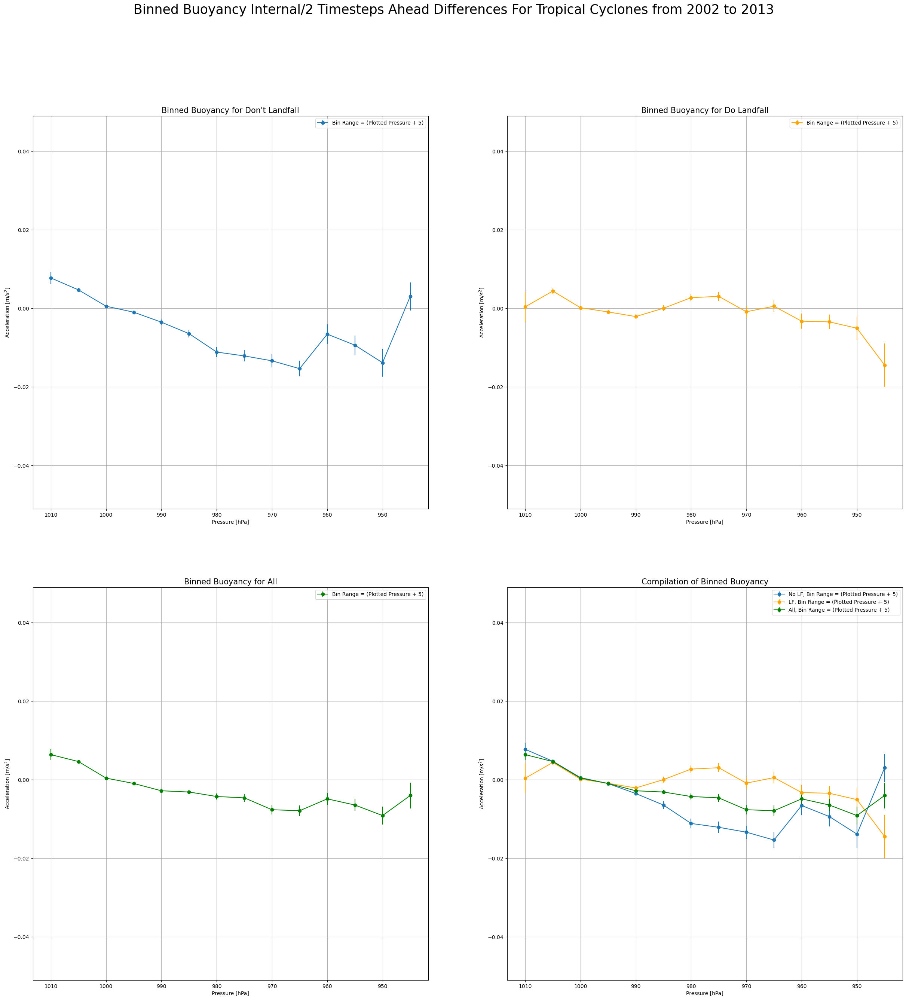

In [47]:
plt.subplots(figsize = (30,30))
plt.subplot(2,2,1) #For NLF
if variable == "EQBL":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(psl_nlf_EQBL_ahead,EQBL_nlf_ahead,buoy_bins) #take bins
    minn=np.average(EQBL_all_ahead)-20
    maxx=np.average(EQBL_all_ahead)+20
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(psl_nlf_EQSLFT_ahead,EQSLFT_nlf_ahead,buoy_bins) #take bins
    minn=np.average(EQSLFT_all_ahead)-20
    maxx=np.average(EQSLFT_all_ahead)+20
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(psl_nlf_EQULFT_ahead,EQULFT_nlf_ahead,buoy_bins) #take bins
    minn=np.average(EQULFT_all_ahead)-20
    maxx=np.average(EQULFT_all_ahead)+20
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)  
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(psl_nlf_Subsat_ahead,Subsat_nlf_ahead,buoy_bins) #take bins
    minn=np.average(Subsat_all_ahead)-4
    maxx=np.average(Subsat_all_ahead)+4
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(psl_nlf_CAPE_ahead,CAPE_nlf_ahead,buoy_bins) #take bins
    minn=np.average(CAPE_all_ahead)-4
    maxx=np.average(CAPE_all_ahead)+4
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(psl_nlf_Buoy_ahead,Buoy_nlf_ahead,buoy_bins) #take bins
    minn=np.average(Buoy_all_ahead)-.05
    maxx=np.average(Buoy_all_ahead)+.05
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(psl_nlf_precip_ahead,precip_nlf_ahead,buoy_bins) #take bins
    minn=np.average(precip_all_ahead)-2
    maxx=np.average(precip_all_ahead)+2
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);   
    
    
plt.errorbar(buoy_bins,nlf_psl_means,nlf_err,color='#1f77b4',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
plt.title("Binned {} for Don't Landfall".format(variable),fontsize=15)


plt.subplot(2,2,2) #For LF
if variable == "EQBL":
    lf_psl_means, lf_err,lf_his = bin_buoyancy(psl_lf_EQBL_ahead,EQBL_lf_ahead,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(psl_lf_EQSLFT_ahead,EQSLFT_lf_ahead,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(psl_lf_EQULFT_ahead,EQULFT_lf_ahead,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(psl_lf_Subsat_ahead,Subsat_lf_ahead,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(psl_lf_CAPE_ahead,CAPE_lf_ahead,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(psl_lf_Buoy_ahead,Buoy_lf_ahead,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(psl_lf_precip_ahead,precip_lf_ahead,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10); 
    
plt.errorbar(buoy_bins,lf_psl_means,lf_err,color='orange',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
plt.title("Binned {} for Do Landfall".format(variable),fontsize=15)


plt.subplot(2,2,3) #For All
if variable == "EQBL":
    all_psl_means, all_err,all_his = bin_buoyancy(psl_all_EQBL_ahead,EQBL_all_ahead,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    all_psl_means, all_err,all_his = bin_buoyancy(psl_all_EQSLFT_ahead,EQSLFT_all_ahead,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    all_psl_means, all_err, all_his = bin_buoyancy(psl_all_EQULFT_ahead,EQULFT_all_ahead,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    all_psl_means, all_err, all_his = bin_buoyancy(psl_all_Subsat_ahead,Subsat_all_ahead,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    all_psl_means, all_err, all_his = bin_buoyancy(psl_all_CAPE_ahead,CAPE_all_ahead,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    all_psl_means, all_err, all_his = bin_buoyancy(psl_all_Buoy_ahead,Buoy_all_ahead,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    all_psl_means, all_err, all_his = bin_buoyancy(psl_all_precip_ahead,precip_all_ahead,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);  

plt.errorbar(buoy_bins,all_psl_means,all_err,color='g',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()    
plt.title("Binned {} for All".format(variable),fontsize=15)


plt.subplot(2,2,4) #For all 3
plt.errorbar(buoy_bins,nlf_psl_means,nlf_err,color='#1f77b4',marker='o', label = "No LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,lf_psl_means,lf_err,color='orange',marker='o', label = "LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,all_psl_means,all_err,color='g',marker='o', label = "All, Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
if variable == "EQBL":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);   
plt.title("Compilation of Binned {}".format(variable),fontsize=15)
plt.suptitle("Binned {} Internal/{} Timesteps Ahead Differences For Tropical Cyclones from 2002 to 2013".format(variable,timeahead), fontsize = 25);

# For Precipitation Bin with CAPE/Subsaturation/Buoyancy for Internal-External

/tmp/ipykernel_300559/3302713981.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2,2,1) #For NLF
/tmp/ipykernel_300559/2195458953.py:27: RuntimeWarning: Mean of empty slice.
  prc=y[indx].mean()


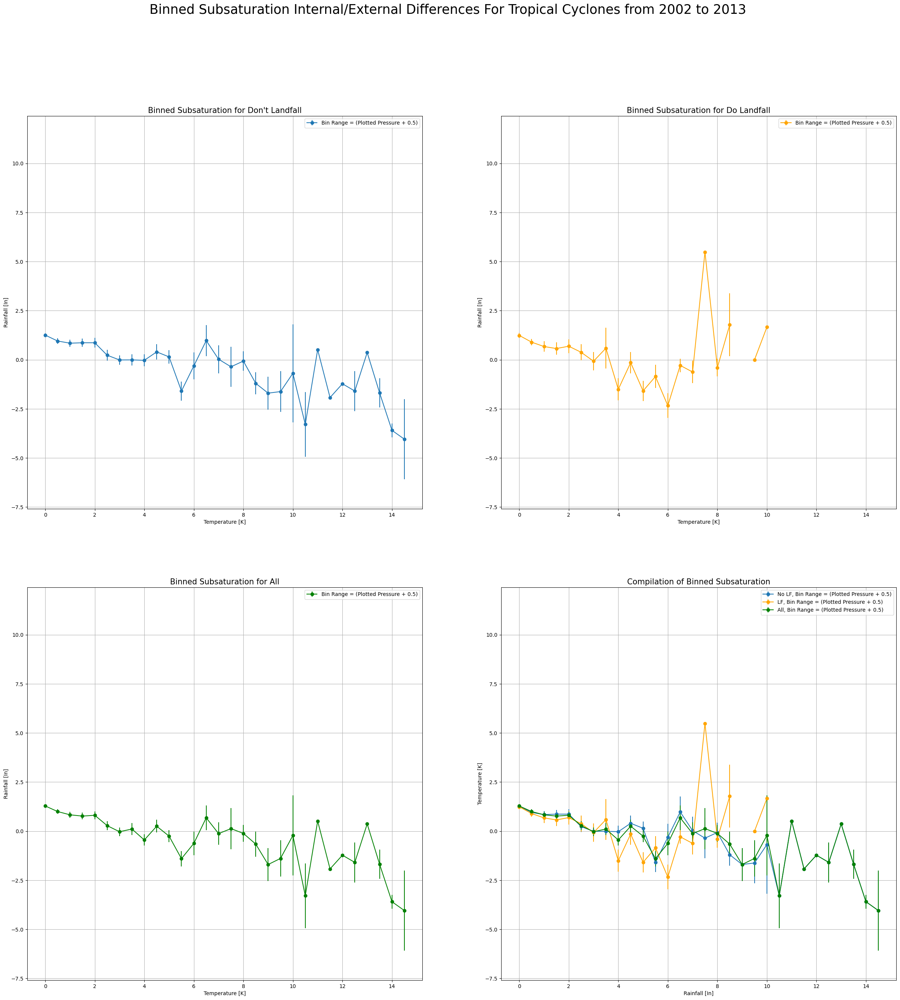

In [234]:
plt.subplots(figsize = (30,30))
plt.subplot(2,2,1) #For NLF
if variable == "Subsaturation":
    ches=.5
    buoy_bins=np.arange(0,15,.5)  
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(precip_nlf_Subsat,precip_Subsat_nlf,buoy_bins) #take bins
    minn=np.average(precip_all)-10
    maxx=np.average(precip_all)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    ches=.5
    buoy_bins=np.arange(-7.5,7.5,.5)  
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(precip_nlf_CAPE,precip_CAPE_nlf,buoy_bins) #take bins
    minn=np.average(precip_all)-10
    maxx=np.average(precip_all)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    ches=.01
    buoy_bins=np.arange(-0.2,.15,0.01)
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(precip_nlf_Buoy,precip_Buoy_nlf,buoy_bins) #take bins
    minn=np.average(precip_all)-10
    maxx=np.average(precip_all)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
    
    
plt.errorbar(buoy_bins,nlf_psl_means,nlf_err,color='#1f77b4',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))

plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()
plt.title("Binned {} for Don't Landfall".format(variable),fontsize=15)


plt.subplot(2,2,2) #For LF
if variable == "Subsaturation":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(precip_lf_Subsat,precip_Subsat_lf,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(precip_lf_CAPE,precip_CAPE_lf,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    lf_psl_means, lf_err, lf_his = bin_buoyancy(precip_lf_Buoy,precip_Buoy_lf,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
    
plt.errorbar(buoy_bins,lf_psl_means,lf_err,color='orange',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()
plt.title("Binned {} for Do Landfall".format(variable),fontsize=15)


plt.subplot(2,2,3) #For All

if variable == "Subsaturation":
    all_psl_means, all_err, all_his = bin_buoyancy(precip_all_Subsat,precip_Subsat_all,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    all_psl_means, all_err, all_his = bin_buoyancy(precip_all_CAPE,precip_CAPE_all,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    all_psl_means, all_err, all_his = bin_buoyancy(precip_all_Buoy,precip_Buoy_all,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);

plt.errorbar(buoy_bins,all_psl_means,all_err,color='g',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()    
plt.title("Binned {} for All".format(variable),fontsize=15)


plt.subplot(2,2,4) #For all 3
plt.errorbar(buoy_bins,nlf_psl_means,nlf_err,color='#1f77b4',marker='o', label = "No LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,lf_psl_means,lf_err,color='orange',marker='o', label = "LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,all_psl_means,all_err,color='g',marker='o', label = "All, Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()

if variable == "Subsaturation":
    plt.xlabel("Rainfall [In]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    plt.xlabel("Rainfall [In]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
    
plt.title("Compilation of Binned {}".format(variable),fontsize=15)
plt.suptitle("Binned {} Internal/External Differences For Tropical Cyclones from 2002 to 2013".format(variable), fontsize = 25);

# For Precipitation Bin with CAPE/Subsaturation/Buoyancy for Internal-(Insert) Timesteps Ahead

/tmp/ipykernel_300559/3985769798.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2,2,1) #For NLF
/tmp/ipykernel_300559/2195458953.py:27: RuntimeWarning: Mean of empty slice.
  prc=y[indx].mean()


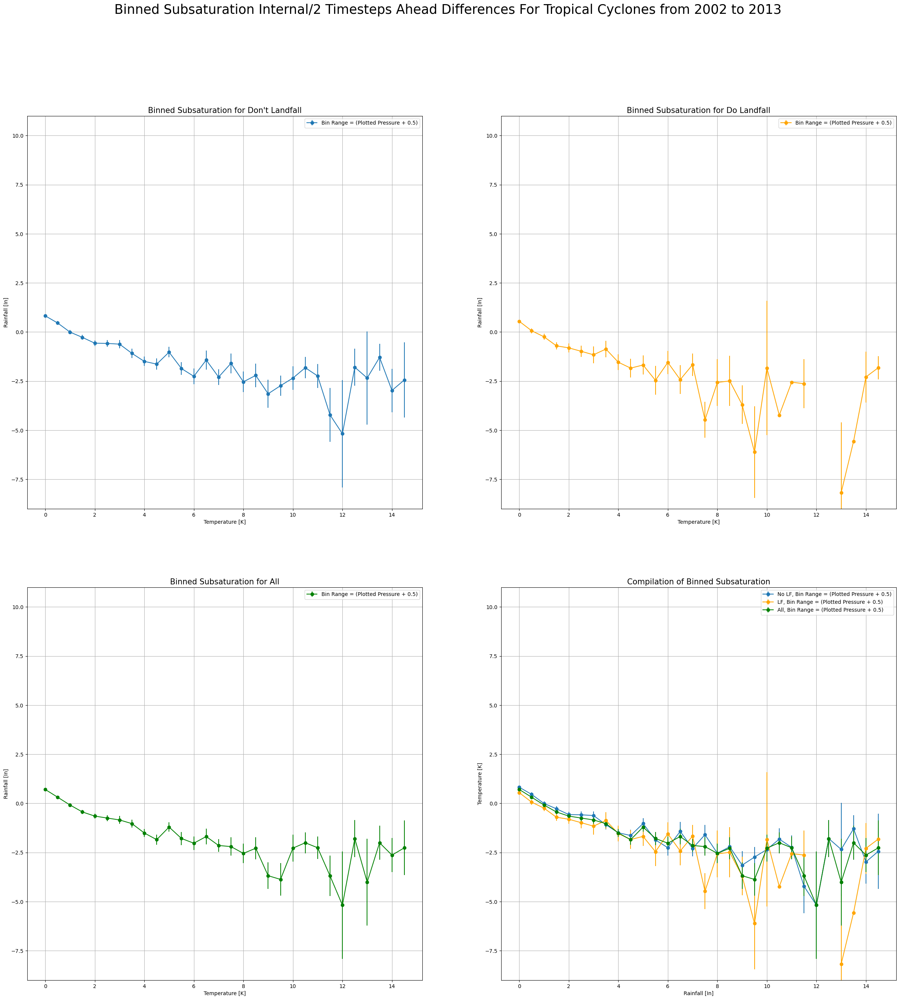

In [235]:
plt.subplots(figsize = (30,30))
plt.subplot(2,2,1) #For NLF
if variable == "Subsaturation":
    ches=.5
    buoy_bins=np.arange(0,15,.5)  
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(precip_nlf_Subsat_ahead,precip_Subsat_nlf_ahead,buoy_bins) #take bins
    minn=np.average(precip_all_ahead)-10
    maxx=np.average(precip_all_ahead)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    ches=.5
    buoy_bins=np.arange(-7.5,7.5,.5)  
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(precip_nlf_CAPE_ahead,precip_CAPE_nlf_ahead,buoy_bins) #take bins
    minn=np.average(precip_all_ahead)-10
    maxx=np.average(precip_all_ahead)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    ches=.01
    buoy_bins=np.arange(-0.2,.15,0.01)
    nlf_psl_means, nlf_err,nlf_his = bin_buoyancy(precip_nlf_Buoy_ahead,precip_Buoy_nlf_ahead,buoy_bins) #take bins
    minn=np.average(precip_all_ahead)-10
    maxx=np.average(precip_all_ahead)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
 
    
    
plt.errorbar(buoy_bins,nlf_psl_means,nlf_err,color='#1f77b4',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))

plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()
plt.title("Binned {} for Don't Landfall".format(variable),fontsize=15)


plt.subplot(2,2,2) #For LF
if variable == "Subsaturation":
    lf_psl_means, lf_err,lf_his = bin_buoyancy(precip_lf_Subsat_ahead,precip_Subsat_lf_ahead,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    lf_psl_means, lf_err,lf_his = bin_buoyancy(precip_lf_CAPE_ahead,precip_CAPE_lf_ahead,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    lf_psl_means, lf_err,lf_his = bin_buoyancy(precip_lf_Buoy_ahead,precip_Buoy_lf_ahead,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);

    
plt.errorbar(buoy_bins,lf_psl_means,lf_err,color='orange',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()
plt.title("Binned {} for Do Landfall".format(variable),fontsize=15)


plt.subplot(2,2,3) #For All

if variable == "Subsaturation":
    all_psl_means, all_err,all_his = bin_buoyancy(precip_all_Subsat_ahead,precip_Subsat_all_ahead,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    all_psl_means, all_err,all_his = bin_buoyancy(precip_all_CAPE_ahead,precip_CAPE_all_ahead,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    all_psl_means, all_err,all_his = bin_buoyancy(precip_all_Buoy_ahead,precip_Buoy_all_ahead,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
 

plt.errorbar(buoy_bins,all_psl_means,all_err,color='g',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()    
plt.title("Binned {} for All".format(variable),fontsize=15)


plt.subplot(2,2,4) #For all 3
plt.errorbar(buoy_bins,nlf_psl_means,nlf_err,color='#1f77b4',marker='o', label = "No LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,lf_psl_means,lf_err,color='orange',marker='o', label = "LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,all_psl_means,all_err,color='g',marker='o', label = "All, Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()

if variable == "Subsaturation":
    plt.xlabel("Rainfall [In]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    plt.xlabel("Rainfall [In]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
  
plt.title("Compilation of Binned {}".format(variable),fontsize=15)
plt.suptitle("Binned {} Internal/{} Timesteps Ahead Differences For Tropical Cyclones from 2002 to 2013".format(variable,timeahead), fontsize = 25);

# Import Data from Internal/External/Timesteps Ahead Data

In [18]:
f_nlfex = open("Buoy_Expanded_Non_Landfall_External.txt", "r") #unpack nonlandfalling external
nlfex = np.loadtxt(f_nlfex, unpack = True)
f_nlfin = open("Buoy_Expanded_Non_Landfall_Internal.txt", "r") #unpack nonlandfalling internal
nlfin = np.loadtxt(f_nlfin, unpack = True)
f_nlfpro = open("Buoy_Expanded_Non_Landfall_Proj.txt", "r") #unpack nonlandfalling ahead
nlfpro = np.loadtxt(f_nlfpro, unpack = True)


f_lfex = open("Buoy_Expanded_Landfall_External.txt", "r") #unpack landfalling external
lfex = np.loadtxt(f_lfex, unpack = True)
f_lfin = open("Buoy_Expanded_Landfall_Internal.txt", "r") #unpack landfalling internal
lfin = np.loadtxt(f_lfin, unpack = True)
f_lfpro = open("Buoy_Expanded_Landfall_Proj.txt", "r") #unpack landfalling ahead
lfpro = np.loadtxt(f_lfpro, unpack = True)

# Clean Data and Create Fits for Each

In [19]:
psl_nlfin = nlfin[1] #create array for pressure (for non_landfall)
wind_nlfin = nlfin[2] #create array for wind (for non_landfall)
EQBL_nlfin = nlfin[3] #creare array for EQBL (for non_landfall)
EQSLFT_nlfin = nlfin[4] #create array for EQSLFT (for non_landfall)
EQULFT_nlfin = nlfin[5] #create array for EQULFT (for non_landfall)
Subsat_nlfin = nlfin[6] #create array for Subsaturation (for non_landfall)
CAPE_nlfin = nlfin[7] #create array for CAPE (for non_landfall)
Buoy_nlfin = nlfin[8] #create array for Buoyancy (for non_landfall)
precip_nlfin = nlfin[9] #create array for precipitation (for non_landfall)

psl_nlfex = nlfex[1] #create array for pressure (for non_landfall)
wind_nlfex = nlfex[2] #create array for wind (for non_landfall)
EQBL_nlfex = nlfex[3] #creare array for EQBL (for non_landfall)
EQSLFT_nlfex = nlfex[4] #create array for EQSLFT (for non_landfall)
EQULFT_nlfex = nlfex[5] #create array for EQULFT (for non_landfall)
Subsat_nlfex = nlfex[6] #create array for Subsaturation (for non_landfall)
CAPE_nlfex = nlfex[7] #create array for CAPE (for non_landfall)
Buoy_nlfex = nlfex[8] #create array for Buoyancy (for non_landfall)
precip_nlfex = nlfex[9] #create array for precipitation (for non_landfall)

psl_nlfpro = nlfpro[1] #create array for pressure (for non_landfall)
wind_nlfpro = nlfpro[2] #create array for wind (for non_landfall)
EQBL_nlfpro = nlfpro[3] #creare array for EQBL (for non_landfall)
EQSLFT_nlfpro = nlfpro[4] #create array for EQSLFT (for non_landfall)
EQULFT_nlfpro = nlfpro[5] #create array for EQULFT (for non_landfall)
Subsat_nlfpro = nlfpro[6] #create array for Subsaturation (for non_landfall)
CAPE_nlfpro = nlfpro[7] #create array for CAPE (for non_landfall)
Buoy_nlfpro = nlfpro[8] #create array for Buoyancy (for non_landfall)
precip_nlfpro = nlfpro[9] #create array for precipitation (for non_landfall)

psl_lfin = lfin[1] #create array for pressure (for landfall)
wind_lfin = lfin[2] #create array for wind (for landfall)
EQBL_lfin = lfin[3] #creare array for EQBL (for landfall)
EQSLFT_lfin = lfin[4] #create array for EQSLFT (for landfall)
EQULFT_lfin = lfin[5] #create array for EQULFT (for landfall)
Subsat_lfin = lfin[6] #create array for Subsaturation (for landfall)
CAPE_lfin = lfin[7] #create array for CAPE (for landfall)
Buoy_lfin = lfin[8] #create array for Buoyancy (for landfall)
precip_lfin = lfin[9] #create array for precipitation (for landfall)

psl_lfex = lfex[1] #create array for pressure (for landfall)
wind_lfex = lfex[2] #create array for wind (for landfall)
EQBL_lfex = lfex[3] #creare array for EQBL (for landfall)
EQSLFT_lfex = lfex[4] #create array for EQSLFT (for landfall)
EQULFT_lfex = lfex[5] #create array for EQULFT (for landfall)
Subsat_lfex = lfex[6] #create array for Subsaturation (for landfall)
CAPE_lfex = lfex[7] #create array for CAPE (for landfall)
Buoy_lfex = lfex[8] #create array for Buoyancy (for landfall)
precip_lfex = lfex[9] #create array for precipitation (for landfall)

psl_lfpro = lfpro[1] #create array for pressure (for landfall)
wind_lfpro = lfpro[2] #create array for wind (for landfall)
EQBL_lfpro = lfpro[3] #creare array for EQBL (for landfall)
EQSLFT_lfpro = lfpro[4] #create array for EQSLFT (for landfall)
EQULFT_lfpro = lfpro[5] #create array for EQULFT (for landfall)
Subsat_lfpro = lfpro[6] #create array for Subsaturation (for landfall)
CAPE_lfpro = lfpro[7] #create array for CAPE (for landfall)
Buoy_lfpro = lfpro[8] #create array for Buoyancy (for landfall)
precip_lfpro = lfpro[9] #create array for precipitation (for landfall)

#Join the two arrays together for internal values
psl_allin=np.append(psl_nlfin,psl_lfin) 
wind_allin=np.append(wind_nlfin,wind_lfin)
EQBL_allin=np.append(EQBL_nlfin,EQBL_lfin)
EQSLFT_allin=np.append(EQSLFT_nlfin,EQSLFT_lfin)
EQULFT_allin=np.append(EQULFT_nlfin,EQULFT_lfin)
Subsat_allin=np.append(Subsat_nlfin,Subsat_lfin)
CAPE_allin=np.append(CAPE_nlfin,CAPE_lfin)
Buoy_allin=np.append(Buoy_nlfin,Buoy_lfin)
precip_allin=np.append(precip_nlfin,precip_lfin)

#Join the two arrays together for external values
psl_allex=np.append(psl_nlfex,psl_lfex) 
wind_allex=np.append(wind_nlfex,wind_lfex)
EQBL_allex=np.append(EQBL_nlfex,EQBL_lfex)
EQSLFT_allex=np.append(EQSLFT_nlfex,EQSLFT_lfex)
EQULFT_allex=np.append(EQULFT_nlfex,EQULFT_lfex)
Subsat_allex=np.append(Subsat_nlfex,Subsat_lfex)
CAPE_allex=np.append(CAPE_nlfex,CAPE_lfex)
Buoy_allex=np.append(Buoy_nlfex,Buoy_lfex)
precip_allex=np.append(precip_nlfex,precip_lfex)

#Join the two arrays together for ahead values
psl_allpro=np.append(psl_nlfpro,psl_lfpro) 
wind_allpro=np.append(wind_nlfpro,wind_lfpro)
EQBL_allpro=np.append(EQBL_nlfpro,EQBL_lfpro)
EQSLFT_allpro=np.append(EQSLFT_nlfpro,EQSLFT_lfpro)
EQULFT_allpro=np.append(EQULFT_nlfpro,EQULFT_lfpro)
Subsat_allpro=np.append(Subsat_nlfpro,Subsat_lfpro)
CAPE_allpro=np.append(CAPE_nlfpro,CAPE_lfpro)
Buoy_allpro=np.append(Buoy_nlfpro,Buoy_lfpro)
precip_allpro=np.append(precip_nlfpro,precip_lfpro)

#Cleans data for precipitation with respect to Subsaturation, CAPE, and Buoyancy

precip_nlfin_Subsat, precip_Subsat_nlfin = cleaningudf(Subsat_nlfin,precip_nlfin)
precip_nlfin_CAPE, precip_CAPE_nlfin = cleaningudf(CAPE_nlfin,precip_nlfin)
precip_lfin_Subsat, precip_Subsat_lfin = cleaningudf(Subsat_lfin,precip_lfin)
precip_lfin_CAPE, precip_CAPE_lfin = cleaningudf(CAPE_lfin,precip_lfin)
precip_allin_Subsat, precip_Subsat_allin = cleaningudf(Subsat_allin,precip_allin)
precip_allin_CAPE, precip_CAPE_allin = cleaningudf(CAPE_allin,precip_allin)
precip_nlfin_Buoy, precip_Buoy_nlfin = cleaningudf(Buoy_nlfin,precip_nlfin)
precip_lfin_Buoy, precip_Buoy_lfin = cleaningudf(Buoy_lfin,precip_lfin)
precip_allin_Buoy, precip_Buoy_allin = cleaningudf(Buoy_allin,precip_allin)

precip_nlfex_Subsat, precip_Subsat_nlfex = cleaningudf(Subsat_nlfex,precip_nlfex)
precip_nlfex_CAPE, precip_CAPE_nlfex = cleaningudf(CAPE_nlfex,precip_nlfex)
precip_lfex_Subsat, precip_Subsat_lfex = cleaningudf(Subsat_lfex,precip_lfex)
precip_lfex_CAPE, precip_CAPE_lfex = cleaningudf(CAPE_lfex,precip_lfex)
precip_allex_Subsat, precip_Subsat_allex = cleaningudf(Subsat_allex,precip_allex)
precip_allex_CAPE, precip_CAPE_allex = cleaningudf(CAPE_allex,precip_allex)
precip_nlfex_Buoy, precip_Buoy_nlfex = cleaningudf(Buoy_nlfex,precip_nlfex)
precip_lfex_Buoy, precip_Buoy_lfex = cleaningudf(Buoy_lfex,precip_lfex)
precip_allex_Buoy, precip_Buoy_allex = cleaningudf(Buoy_allex,precip_allex)

precip_nlfpro_Subsat, precip_Subsat_nlfpro = cleaningudf(Subsat_nlfpro,precip_nlfpro)
precip_nlfpro_CAPE, precip_CAPE_nlfpro = cleaningudf(CAPE_nlfpro,precip_nlfpro)
precip_lfpro_Subsat, precip_Subsat_lfpro = cleaningudf(Subsat_lfpro,precip_lfpro)
precip_lfpro_CAPE, precip_CAPE_lfpro = cleaningudf(CAPE_lfpro,precip_lfpro)
precip_allpro_Subsat, precip_Subsat_allpro = cleaningudf(Subsat_allpro,precip_allpro)
precip_allpro_CAPE, precip_CAPE_allpro = cleaningudf(CAPE_allpro,precip_allpro)
precip_nlfpro_Buoy, precip_Buoy_nlfpro = cleaningudf(Buoy_nlfpro,precip_nlfpro)
precip_lfpro_Buoy, precip_Buoy_lfpro = cleaningudf(Buoy_lfpro,precip_lfpro)
precip_allpro_Buoy, precip_Buoy_allpro = cleaningudf(Buoy_allpro,precip_allpro)


#Clean non-landfalling values in relation to minimum pressure
psl_nlfin_EQBL, EQBL_nlfin = cleaningudf(psl_nlfin,EQBL_nlfin)
psl_nlfin_EQSLFT, EQSLFT_nlfin = cleaningudf(psl_nlfin,EQSLFT_nlfin) 
psl_nlfin_EQULFT, EQULFT_nlfin = cleaningudf(psl_nlfin,EQULFT_nlfin) 
psl_nlfin_Subsat, Subsat_nlfin = cleaningudf(psl_nlfin,Subsat_nlfin)
psl_nlfin_CAPE, CAPE_nlfin = cleaningudf(psl_nlfin,CAPE_nlfin)
psl_nlfin_Buoy, Buoy_nlfin = cleaningudf(psl_nlfin,Buoy_nlfin)
psl_nlfin_precip, precip_nlfin = cleaningudf(psl_nlfin,precip_nlfin)

psl_nlfex_EQBL, EQBL_nlfex = cleaningudf(psl_nlfex,EQBL_nlfex)
psl_nlfex_EQSLFT, EQSLFT_nlfex = cleaningudf(psl_nlfex,EQSLFT_nlfex) 
psl_nlfex_EQULFT, EQULFT_nlfex = cleaningudf(psl_nlfex,EQULFT_nlfex) 
psl_nlfex_Subsat, Subsat_nlfex = cleaningudf(psl_nlfex,Subsat_nlfex)
psl_nlfex_CAPE, CAPE_nlfex = cleaningudf(psl_nlfex,CAPE_nlfex)
psl_nlfex_Buoy, Buoy_nlfex = cleaningudf(psl_nlfex,Buoy_nlfex)
psl_nlfex_precip, precip_nlfex = cleaningudf(psl_nlfex,precip_nlfex)

psl_nlfpro_EQBL, EQBL_nlfpro = cleaningudf(psl_nlfpro,EQBL_nlfpro)
psl_nlfpro_EQSLFT, EQSLFT_nlfpro = cleaningudf(psl_nlfpro,EQSLFT_nlfpro) 
psl_nlfpro_EQULFT, EQULFT_nlfpro = cleaningudf(psl_nlfpro,EQULFT_nlfpro) 
psl_nlfpro_Subsat, Subsat_nlfpro = cleaningudf(psl_nlfpro,Subsat_nlfpro)
psl_nlfpro_CAPE, CAPE_nlfpro = cleaningudf(psl_nlfpro,CAPE_nlfpro)
psl_nlfpro_Buoy, Buoy_nlfpro = cleaningudf(psl_nlfpro,Buoy_nlfpro)
psl_nlfpro_precip, precip_nlfpro = cleaningudf(psl_nlfpro,precip_nlfpro)

#Clean landfalling values in relation to minimum pressure
psl_lfin_EQBL, EQBL_lfin = cleaningudf(psl_lfin,EQBL_lfin)
psl_lfin_EQSLFT, EQSLFT_lfin = cleaningudf(psl_lfin,EQSLFT_lfin) 
psl_lfin_EQULFT, EQULFT_lfin = cleaningudf(psl_lfin,EQULFT_lfin) 
psl_lfin_Subsat, Subsat_lfin = cleaningudf(psl_lfin,Subsat_lfin)
psl_lfin_CAPE, CAPE_lfin = cleaningudf(psl_lfin,CAPE_lfin)
psl_lfin_Buoy, Buoy_lfin = cleaningudf(psl_lfin,Buoy_lfin)
psl_lfin_precip, precip_lfin = cleaningudf(psl_lfin,precip_lfin)

psl_lfex_EQBL, EQBL_lfex = cleaningudf(psl_lfex,EQBL_lfex)
psl_lfex_EQSLFT, EQSLFT_lfex = cleaningudf(psl_lfex,EQSLFT_lfex) 
psl_lfex_EQULFT, EQULFT_lfex = cleaningudf(psl_lfex,EQULFT_lfex) 
psl_lfex_Subsat, Subsat_lfex = cleaningudf(psl_lfex,Subsat_lfex)
psl_lfex_CAPE, CAPE_lfex = cleaningudf(psl_lfex,CAPE_lfex)
psl_lfex_Buoy, Buoy_lfex = cleaningudf(psl_lfex,Buoy_lfex)
psl_lfex_precip, precip_lfex = cleaningudf(psl_lfex,precip_lfex)

psl_lfpro_EQBL, EQBL_lfpro = cleaningudf(psl_lfpro,EQBL_lfpro)
psl_lfpro_EQSLFT, EQSLFT_lfpro = cleaningudf(psl_lfpro,EQSLFT_lfpro) 
psl_lfpro_EQULFT, EQULFT_lfpro = cleaningudf(psl_lfpro,EQULFT_lfpro) 
psl_lfpro_Subsat, Subsat_lfpro = cleaningudf(psl_lfpro,Subsat_lfpro)
psl_lfpro_CAPE, CAPE_lfpro = cleaningudf(psl_lfpro,CAPE_lfpro)
psl_lfpro_Buoy, Buoy_lfpro = cleaningudf(psl_lfpro,Buoy_lfpro)
psl_lfpro_precip, precip_lfpro = cleaningudf(psl_lfpro,precip_lfpro)

#Clean all values in relation to minimum pressure
psl_allin_EQBL, EQBL_allin = cleaningudf(psl_allin,EQBL_allin)
psl_allin_EQSLFT, EQSLFT_allin = cleaningudf(psl_allin,EQSLFT_allin) 
psl_allin_EQULFT, EQULFT_allin = cleaningudf(psl_allin,EQULFT_allin) 
psl_allin_Subsat, Subsat_allin = cleaningudf(psl_allin,Subsat_allin)
psl_allin_CAPE, CAPE_allin = cleaningudf(psl_allin,CAPE_allin)
psl_allin_Buoy, Buoy_allin = cleaningudf(psl_allin,Buoy_allin)
psl_allin_precip, precip_allin = cleaningudf(psl_allin,precip_allin)

psl_allex_EQBL, EQBL_allex = cleaningudf(psl_allex,EQBL_allex)
psl_allex_EQSLFT, EQSLFT_allex = cleaningudf(psl_allex,EQSLFT_allex) 
psl_allex_EQULFT, EQULFT_allex = cleaningudf(psl_allex,EQULFT_allex) 
psl_allex_Subsat, Subsat_allex = cleaningudf(psl_allex,Subsat_allex)
psl_allex_CAPE, CAPE_allex = cleaningudf(psl_allex,CAPE_allex)
psl_allex_Buoy, Buoy_allex = cleaningudf(psl_allex,Buoy_allex)
psl_allex_precip, precip_allex = cleaningudf(psl_allex,precip_allex)

psl_allpro_EQBL, EQBL_allpro = cleaningudf(psl_allpro,EQBL_allpro)
psl_allpro_EQSLFT, EQSLFT_allpro = cleaningudf(psl_allpro,EQSLFT_allpro) 
psl_allpro_EQULFT, EQULFT_allpro = cleaningudf(psl_allpro,EQULFT_allpro) 
psl_allpro_Subsat, Subsat_allpro = cleaningudf(psl_allpro,Subsat_allpro)
psl_allpro_CAPE, CAPE_allpro = cleaningudf(psl_allpro,CAPE_allpro)
psl_allpro_Buoy, Buoy_allpro = cleaningudf(psl_allpro,Buoy_allpro)
psl_allpro_precip, precip_allpro = cleaningudf(psl_allpro,precip_allpro)


#fitting non-landfalling internal values
EQBl_nlfin_fit = fitter_udf(psl_nlfin_EQBL,EQBL_nlfin)
EQBl_nlfin_rsq = Rsq_udf(psl_nlfin_EQBL,EQBL_nlfin)
EQSLFT_nlfin_fit = fitter_udf(psl_nlfin_EQSLFT,EQSLFT_nlfin)
EQSLFT_nlfin_rsq = Rsq_udf(psl_nlfin_EQSLFT,EQSLFT_nlfin)
EQULFT_nlfin_fit = fitter_udf(psl_nlfin_EQULFT,EQULFT_nlfin)
EQULFT_nlfin_rsq = Rsq_udf(psl_nlfin_EQULFT,EQULFT_nlfin)
Subsat_nlfin_fit = fitter_udf(psl_nlfin_Subsat,Subsat_nlfin)
Subsat_nlfin_rsq = Rsq_udf(psl_nlfin_Subsat,Subsat_nlfin)                              
CAPE_nlfin_fit = fitter_udf(psl_nlfin_CAPE,CAPE_nlfin)
CAPE_nlfin_rsq = Rsq_udf(psl_nlfin_CAPE,CAPE_nlfin)           
Buoy_nlfin_fit = fitter_udf(psl_nlfin_Buoy,Buoy_nlfin)
Buoy_nlfin_rsq = Rsq_udf(psl_nlfin_Buoy,Buoy_nlfin)
precip_nlfin_fit = fitter_udf(psl_nlfin_precip,precip_nlfin)
precip_nlfin_rsq = Rsq_udf(psl_nlfin_precip,precip_nlfin)
wind_nlfin_fit = fitter_udf(psl_nlfin,wind_nlfin)
wind_nlfin_rsq = Rsq_udf(psl_nlfin,wind_nlfin)

#fitting non-landfalling external values
EQBl_nlfex_fit = fitter_udf(psl_nlfex_EQBL,EQBL_nlfex)
EQBl_nlfex_rsq = Rsq_udf(psl_nlfex_EQBL,EQBL_nlfex)
EQSLFT_nlfex_fit = fitter_udf(psl_nlfex_EQSLFT,EQSLFT_nlfex)
EQSLFT_nlfex_rsq = Rsq_udf(psl_nlfex_EQSLFT,EQSLFT_nlfex)
EQULFT_nlfex_fit = fitter_udf(psl_nlfex_EQULFT,EQULFT_nlfex)
EQULFT_nlfex_rsq = Rsq_udf(psl_nlfex_EQULFT,EQULFT_nlfex)
Subsat_nlfex_fit = fitter_udf(psl_nlfex_Subsat,Subsat_nlfex)
Subsat_nlfex_rsq = Rsq_udf(psl_nlfex_Subsat,Subsat_nlfex)                              
CAPE_nlfex_fit = fitter_udf(psl_nlfex_CAPE,CAPE_nlfex)
CAPE_nlfex_rsq = Rsq_udf(psl_nlfex_CAPE,CAPE_nlfex)           
Buoy_nlfex_fit = fitter_udf(psl_nlfex_Buoy,Buoy_nlfex)
Buoy_nlfex_rsq = Rsq_udf(psl_nlfex_Buoy,Buoy_nlfex)
precip_nlfex_fit = fitter_udf(psl_nlfex_precip,precip_nlfex)
precip_nlfex_rsq = Rsq_udf(psl_nlfex_precip,precip_nlfex)
wind_nlfex_fit = fitter_udf(psl_nlfex,wind_nlfex)
wind_nlfex_rsq = Rsq_udf(psl_nlfex,wind_nlfex)

#fitting non-landfalling ahead values
EQBl_nlfpro_fit = fitter_udf(psl_nlfpro_EQBL,EQBL_nlfpro)
EQBl_nlfpro_rsq = Rsq_udf(psl_nlfpro_EQBL,EQBL_nlfpro)
EQSLFT_nlfpro_fit = fitter_udf(psl_nlfpro_EQSLFT,EQSLFT_nlfpro)
EQSLFT_nlfpro_rsq = Rsq_udf(psl_nlfpro_EQSLFT,EQSLFT_nlfpro)
EQULFT_nlfpro_fit = fitter_udf(psl_nlfpro_EQULFT,EQULFT_nlfpro)
EQULFT_nlfpro_rsq = Rsq_udf(psl_nlfpro_EQULFT,EQULFT_nlfpro)
Subsat_nlfpro_fit = fitter_udf(psl_nlfpro_Subsat,Subsat_nlfpro)
Subsat_nlfpro_rsq = Rsq_udf(psl_nlfpro_Subsat,Subsat_nlfpro)                              
CAPE_nlfpro_fit = fitter_udf(psl_nlfpro_CAPE,CAPE_nlfpro)
CAPE_nlfpro_rsq = Rsq_udf(psl_nlfpro_CAPE,CAPE_nlfpro)           
Buoy_nlfpro_fit = fitter_udf(psl_nlfpro_Buoy,Buoy_nlfpro)
Buoy_nlfpro_rsq = Rsq_udf(psl_nlfpro_Buoy,Buoy_nlfpro)
precip_nlfpro_fit = fitter_udf(psl_nlfpro_precip,precip_nlfpro)
precip_nlfpro_rsq = Rsq_udf(psl_nlfpro_precip,precip_nlfpro)
wind_nlfpro_fit = fitter_udf(psl_nlfpro,wind_nlfpro)
wind_nlfpro_rsq = Rsq_udf(psl_nlfpro,wind_nlfpro)

#fitting landfalling internal values
EQBl_lfin_fit = fitter_udf(psl_lfin_EQBL,EQBL_lfin)
EQBl_lfin_rsq = Rsq_udf(psl_lfin_EQBL,EQBL_lfin)
EQSLFT_lfin_fit = fitter_udf(psl_lfin_EQSLFT,EQSLFT_lfin)
EQSLFT_lfin_rsq = Rsq_udf(psl_lfin_EQSLFT,EQSLFT_lfin)
EQULFT_lfin_fit = fitter_udf(psl_lfin_EQULFT,EQULFT_lfin)
EQULFT_lfin_rsq = Rsq_udf(psl_lfin_EQULFT,EQULFT_lfin)
Subsat_lfin_fit = fitter_udf(psl_lfin_Subsat,Subsat_lfin)
Subsat_lfin_rsq = Rsq_udf(psl_lfin_Subsat,Subsat_lfin)                              
CAPE_lfin_fit = fitter_udf(psl_lfin_CAPE,CAPE_lfin)
CAPE_lfin_rsq = Rsq_udf(psl_lfin_CAPE,CAPE_lfin)           
Buoy_lfin_fit = fitter_udf(psl_lfin_Buoy,Buoy_lfin)
Buoy_lfin_rsq = Rsq_udf(psl_lfin_Buoy,Buoy_lfin)
precip_lfin_fit = fitter_udf(psl_lfin_precip,precip_lfin)
precip_lfin_rsq = Rsq_udf(psl_lfin_precip,precip_lfin)
wind_lfin_fit = fitter_udf(psl_lfin,wind_lfin)
wind_lfin_rsq = Rsq_udf(psl_lfin,wind_lfin)

#fitting landfalling external values
EQBl_lfex_fit = fitter_udf(psl_lfex_EQBL,EQBL_lfex)
EQBl_lfex_rsq = Rsq_udf(psl_lfex_EQBL,EQBL_lfex)
EQSLFT_lfex_fit = fitter_udf(psl_lfex_EQSLFT,EQSLFT_lfex)
EQSLFT_lfex_rsq = Rsq_udf(psl_lfex_EQSLFT,EQSLFT_lfex)
EQULFT_lfex_fit = fitter_udf(psl_lfex_EQULFT,EQULFT_lfex)
EQULFT_lfex_rsq = Rsq_udf(psl_lfex_EQULFT,EQULFT_lfex)
Subsat_lfex_fit = fitter_udf(psl_lfex_Subsat,Subsat_lfex)
Subsat_lfex_rsq = Rsq_udf(psl_lfex_Subsat,Subsat_lfex)                              
CAPE_lfex_fit = fitter_udf(psl_lfex_CAPE,CAPE_lfex)
CAPE_lfex_rsq = Rsq_udf(psl_lfex_CAPE,CAPE_lfex)           
Buoy_lfex_fit = fitter_udf(psl_lfex_Buoy,Buoy_lfex)
Buoy_lfex_rsq = Rsq_udf(psl_lfex_Buoy,Buoy_lfex)
precip_lfex_fit = fitter_udf(psl_lfex_precip,precip_lfex)
precip_lfex_rsq = Rsq_udf(psl_lfex_precip,precip_lfex)
wind_lfex_fit = fitter_udf(psl_lfex,wind_lfex)
wind_lfex_rsq = Rsq_udf(psl_lfex,wind_lfex)

#fitting landfalling ahead values
EQBl_lfpro_fit = fitter_udf(psl_lfpro_EQBL,EQBL_lfpro)
EQBl_lfpro_rsq = Rsq_udf(psl_lfpro_EQBL,EQBL_lfpro)
EQSLFT_lfpro_fit = fitter_udf(psl_lfpro_EQSLFT,EQSLFT_lfpro)
EQSLFT_lfpro_rsq = Rsq_udf(psl_lfpro_EQSLFT,EQSLFT_lfpro)
EQULFT_lfpro_fit = fitter_udf(psl_lfpro_EQULFT,EQULFT_lfpro)
EQULFT_lfpro_rsq = Rsq_udf(psl_lfpro_EQULFT,EQULFT_lfpro)
Subsat_lfpro_fit = fitter_udf(psl_lfpro_Subsat,Subsat_lfpro)
Subsat_lfpro_rsq = Rsq_udf(psl_lfpro_Subsat,Subsat_lfpro)                              
CAPE_lfpro_fit = fitter_udf(psl_lfpro_CAPE,CAPE_lfpro)
CAPE_lfpro_rsq = Rsq_udf(psl_lfpro_CAPE,CAPE_lfpro)           
Buoy_lfpro_fit = fitter_udf(psl_lfpro_Buoy,Buoy_lfpro)
Buoy_lfpro_rsq = Rsq_udf(psl_lfpro_Buoy,Buoy_lfpro)
precip_lfpro_fit = fitter_udf(psl_lfpro_precip,precip_lfpro)
precip_lfpro_rsq = Rsq_udf(psl_lfpro_precip,precip_lfpro)
wind_lfpro_fit = fitter_udf(psl_lfpro,wind_lfpro)
wind_lfpro_rsq = Rsq_udf(psl_lfpro,wind_lfpro)

#fitting all internal values
EQBl_allin_fit = fitter_udf(psl_allin_EQBL,EQBL_allin)
EQBl_allin_rsq = Rsq_udf(psl_allin_EQBL,EQBL_allin)
EQSLFT_allin_fit = fitter_udf(psl_allin_EQSLFT,EQSLFT_allin)
EQSLFT_allin_rsq = Rsq_udf(psl_allin_EQSLFT,EQSLFT_allin)
EQULFT_allin_fit = fitter_udf(psl_allin_EQULFT,EQULFT_allin)
EQULFT_allin_rsq = Rsq_udf(psl_allin_EQULFT,EQULFT_allin)
Subsat_allin_fit = fitter_udf(psl_allin_Subsat,Subsat_allin)
Subsat_allin_rsq = Rsq_udf(psl_allin_Subsat,Subsat_allin)                              
CAPE_allin_fit = fitter_udf(psl_allin_CAPE,CAPE_allin)
CAPE_allin_rsq = Rsq_udf(psl_allin_CAPE,CAPE_allin)           
Buoy_allin_fit = fitter_udf(psl_allin_Buoy,Buoy_allin)
Buoy_allin_rsq = Rsq_udf(psl_allin_Buoy,Buoy_allin)
precip_allin_fit = fitter_udf(psl_allin_precip,precip_allin)
precip_allin_rsq = Rsq_udf(psl_allin_precip,precip_allin)
wind_allin_fit = fitter_udf(psl_allin,wind_allin)
wind_allin_rsq = Rsq_udf(psl_allin,wind_allin)

#fitting all external values
EQBl_allex_fit = fitter_udf(psl_allex_EQBL,EQBL_allex)
EQBl_allex_rsq = Rsq_udf(psl_allex_EQBL,EQBL_allex)
EQSLFT_allex_fit = fitter_udf(psl_allex_EQSLFT,EQSLFT_allex)
EQSLFT_allex_rsq = Rsq_udf(psl_allex_EQSLFT,EQSLFT_allex)
EQULFT_allex_fit = fitter_udf(psl_allex_EQULFT,EQULFT_allex)
EQULFT_allex_rsq = Rsq_udf(psl_allex_EQULFT,EQULFT_allex)
Subsat_allex_fit = fitter_udf(psl_allex_Subsat,Subsat_allex)
Subsat_allex_rsq = Rsq_udf(psl_allex_Subsat,Subsat_allex)                              
CAPE_allex_fit = fitter_udf(psl_allex_CAPE,CAPE_allex)
CAPE_allex_rsq = Rsq_udf(psl_allex_CAPE,CAPE_allex)           
Buoy_allex_fit = fitter_udf(psl_allex_Buoy,Buoy_allex)
Buoy_allex_rsq = Rsq_udf(psl_allex_Buoy,Buoy_allex)
precip_allex_fit = fitter_udf(psl_allex_precip,precip_allex)
precip_allex_rsq = Rsq_udf(psl_allex_precip,precip_allex)
wind_allex_fit = fitter_udf(psl_allex,wind_allex)
wind_allex_rsq = Rsq_udf(psl_allex,wind_allex)

#fitting all ahead values
EQBl_allpro_fit = fitter_udf(psl_allpro_EQBL,EQBL_allpro)
EQBl_allpro_rsq = Rsq_udf(psl_allpro_EQBL,EQBL_allpro)
EQSLFT_allpro_fit = fitter_udf(psl_allpro_EQSLFT,EQSLFT_allpro)
EQSLFT_allpro_rsq = Rsq_udf(psl_allpro_EQSLFT,EQSLFT_allpro)
EQULFT_allpro_fit = fitter_udf(psl_allpro_EQULFT,EQULFT_allpro)
EQULFT_allpro_rsq = Rsq_udf(psl_allpro_EQULFT,EQULFT_allpro)
Subsat_allpro_fit = fitter_udf(psl_allpro_Subsat,Subsat_allpro)
Subsat_allpro_rsq = Rsq_udf(psl_allpro_Subsat,Subsat_allpro)                              
CAPE_allpro_fit = fitter_udf(psl_allpro_CAPE,CAPE_allpro)
CAPE_allpro_rsq = Rsq_udf(psl_allpro_CAPE,CAPE_allpro)           
Buoy_allpro_fit = fitter_udf(psl_allpro_Buoy,Buoy_allpro)
Buoy_allpro_rsq = Rsq_udf(psl_allpro_Buoy,Buoy_allpro)
precip_allpro_fit = fitter_udf(psl_allpro_precip,precip_allpro)
precip_allpro_rsq = Rsq_udf(psl_allpro_precip,precip_allpro)
wind_allpro_fit = fitter_udf(psl_allpro,wind_allpro)
wind_allpro_rsq = Rsq_udf(psl_allpro,wind_allpro)

# Internal Plots for Non-Landalling

/tmp/ipykernel_300559/1965213611.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


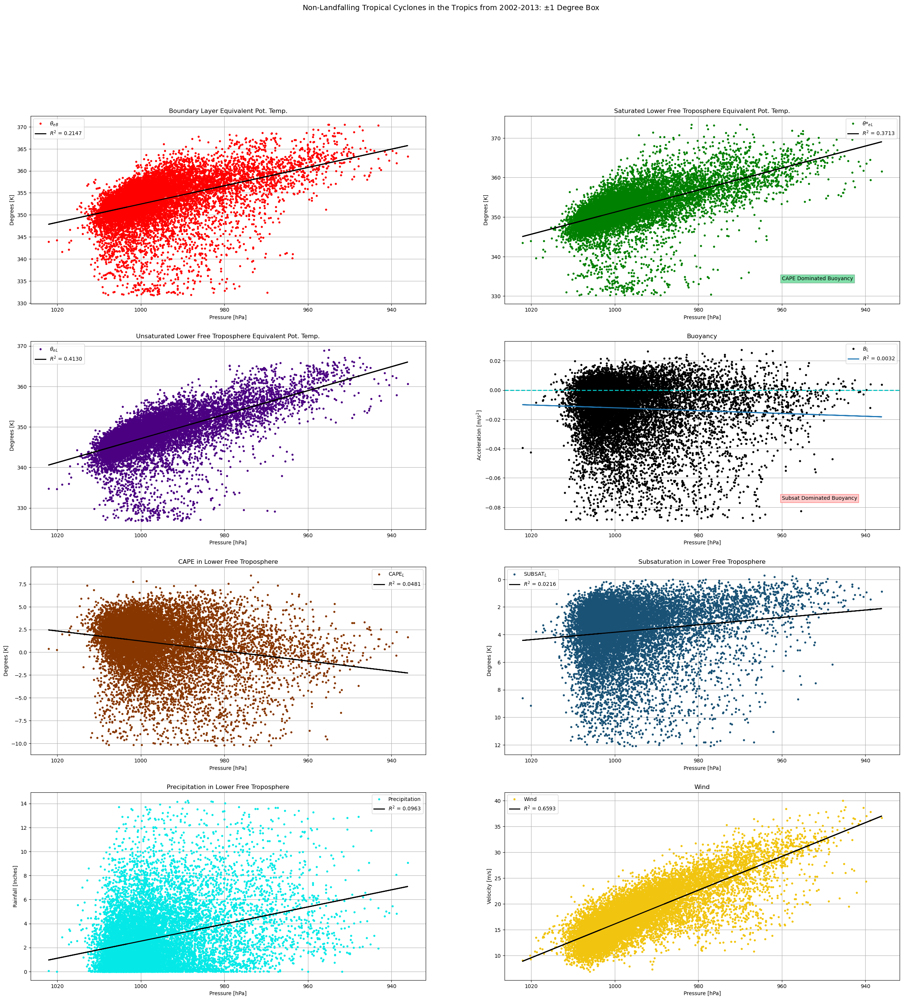

In [140]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_nlfin_EQBL,EQBL_nlfin, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_nlfin_EQBL,EQBl_nlfin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_nlfin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_nlfin_EQSLFT,EQSLFT_nlfin, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_nlfin_EQSLFT,EQSLFT_nlfin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_nlfin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_nlfin_EQULFT,EQULFT_nlfin, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_nlfin_EQULFT,EQULFT_nlfin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_nlfin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_nlfin_Buoy,Buoy_nlfin, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_nlfin_Buoy,Buoy_nlfin_fit[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_nlfin_rsq))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_nlfin_CAPE,CAPE_nlfin, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_nlfin_CAPE,CAPE_nlfin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_nlfin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_nlfin_Subsat,Subsat_nlfin, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_nlfin_Subsat,Subsat_nlfin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_nlfin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_nlfin_precip,precip_nlfin, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_nlfin_precip,precip_nlfin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_nlfin_rsq))

plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_nlfin,wind_nlfin, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_nlfin,wind_nlfin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_nlfin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('Non-Landfalling Tropical Cyclones in the Tropics from 2002-2013: $\u00B1${} Degree Box'.format(internal),fontsize=14);


# Internal Plots for Landalling

/tmp/ipykernel_300559/2569878235.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


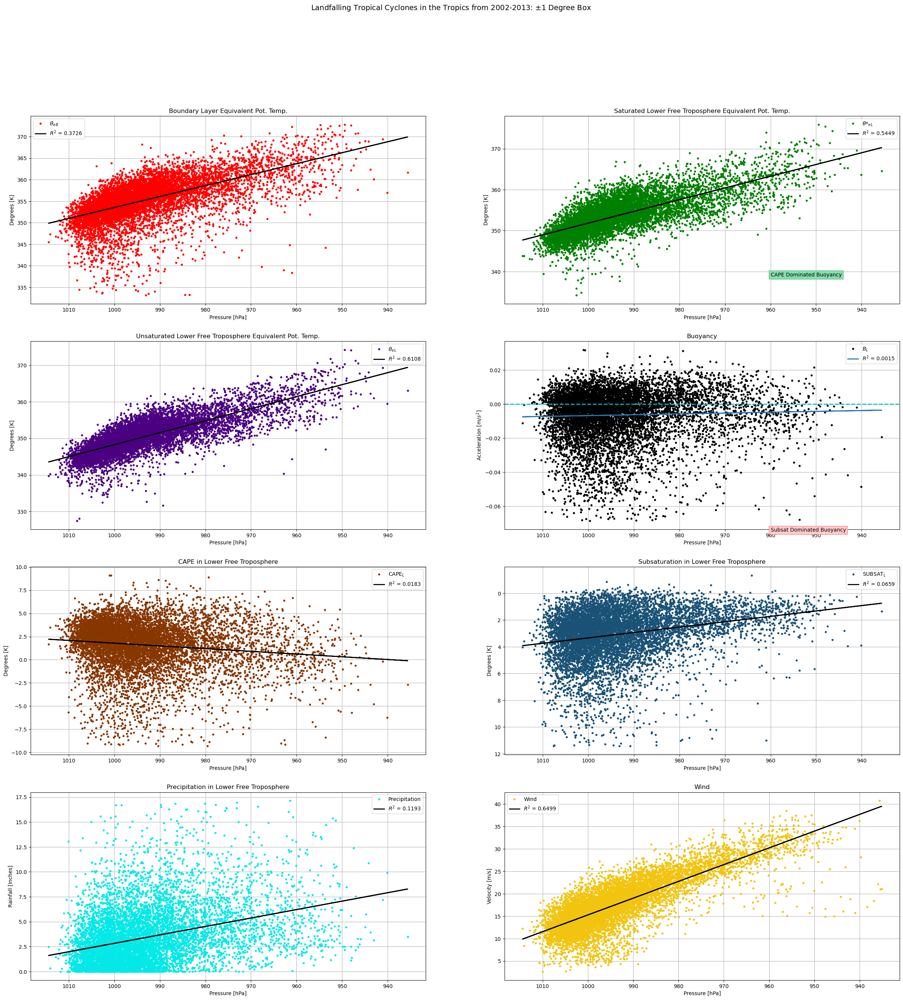

In [69]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_lfin_EQBL,EQBL_lfin, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_lfin_EQBL,EQBl_lfin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_lfin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_lfin_EQSLFT,EQSLFT_lfin, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_lfin_EQSLFT,EQSLFT_lfin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_lfin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_lfin_EQULFT,EQULFT_lfin, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_lfin_EQULFT,EQULFT_lfin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_lfin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_lfin_Buoy,Buoy_lfin, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_lfin_Buoy,Buoy_lfin_fit[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_lfin_rsq))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_lfin_CAPE,CAPE_lfin, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_lfin_CAPE,CAPE_lfin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_lfin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_lfin_Subsat,Subsat_lfin, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_lfin_Subsat,Subsat_lfin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_lfin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_lfin_precip,precip_lfin, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_lfin_precip,precip_lfin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_lfin_rsq))

plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_lfin,wind_lfin, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_lfin,wind_lfin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_lfin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('Landfalling Tropical Cyclones in the Tropics from 2002-2013: $\u00B1${} Degree Box'.format(internal),fontsize=14);


# Internal Plots for All

/tmp/ipykernel_383045/2264762137.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


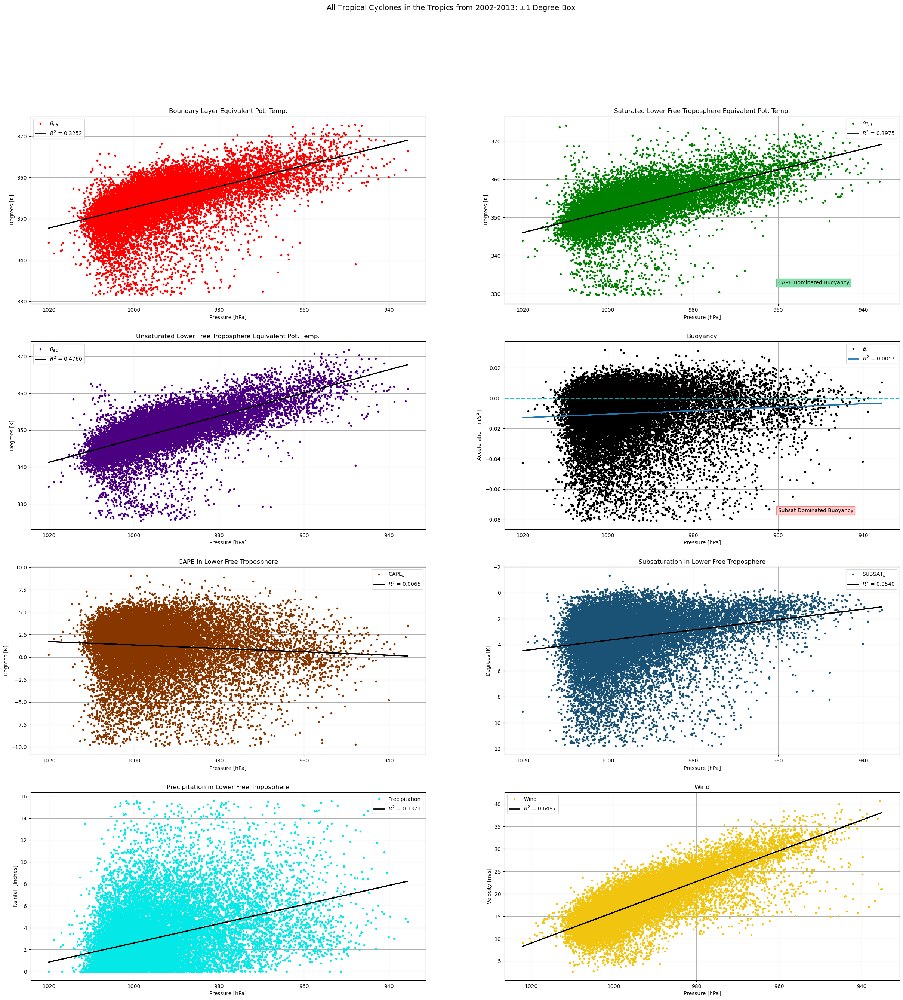

In [24]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_allin_EQBL,EQBL_allin, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_allin_EQBL,EQBl_allin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_allin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_allin_EQSLFT,EQSLFT_allin, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_allin_EQSLFT,EQSLFT_allin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_allin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_allin_EQULFT,EQULFT_allin, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_allin_EQULFT,EQULFT_allin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_allin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_allin_Buoy,Buoy_allin, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_allin_Buoy,Buoy_allin_fit[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_allin_rsq))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_allin_CAPE,CAPE_allin, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_allin_CAPE,CAPE_allin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_allin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_allin_Subsat,Subsat_allin, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_allin_Subsat,Subsat_allin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_allin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_allin_precip,precip_allin, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_allin_precip,precip_allin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_allin_rsq))

plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_allin,wind_allin, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_allin,wind_allin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_allin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('All Tropical Cyclones in the Tropics from 2002-2013: $\u00B1${} Degree Box'.format(internal),fontsize=14);


# External Plots for Non-Landalling

/tmp/ipykernel_300559/2335873662.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


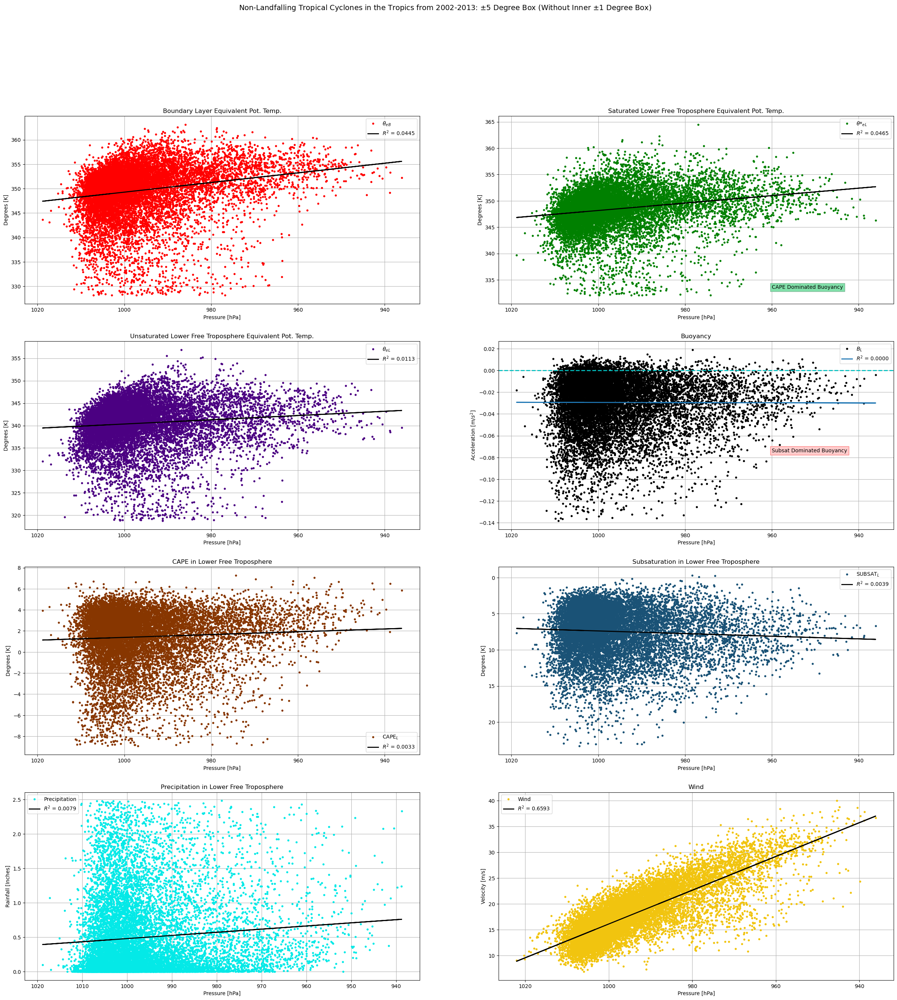

In [71]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_nlfex_EQBL,EQBL_nlfex, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_nlfex_EQBL,EQBl_nlfex_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_nlfex_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_nlfex_EQSLFT,EQSLFT_nlfex, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_nlfex_EQSLFT,EQSLFT_nlfex_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_nlfex_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_nlfex_EQULFT,EQULFT_nlfex, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_nlfex_EQULFT,EQULFT_nlfex_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_nlfex_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_nlfex_Buoy,Buoy_nlfex, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_nlfex_Buoy,Buoy_nlfex_fit[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_nlfex_rsq))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_nlfex_CAPE,CAPE_nlfex, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_nlfex_CAPE,CAPE_nlfex_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_nlfex_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_nlfex_Subsat,Subsat_nlfex, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_nlfex_Subsat,Subsat_nlfex_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_nlfex_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_nlfex_precip,precip_nlfex, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_nlfex_precip,precip_nlfex_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_nlfex_rsq))

plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_nlfex,wind_nlfex, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_nlfex,wind_nlfex_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_nlfex_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('Non-Landfalling Tropical Cyclones in the Tropics from 2002-2013: $\u00B1${} Degree Box (Without Inner $\u00B1${} Degree Box)'.format(offset,internal),fontsize=14);


# External Plots for Landalling

/tmp/ipykernel_300559/2884069469.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


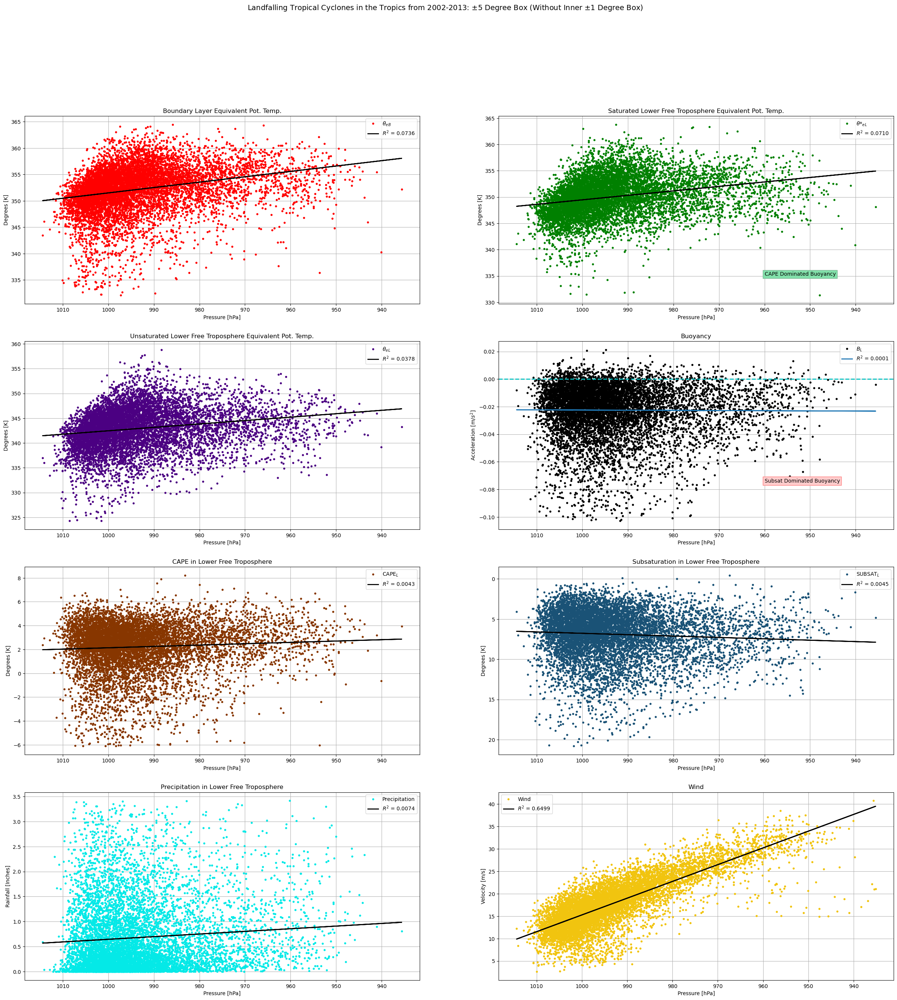

In [72]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_lfex_EQBL,EQBL_lfex, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_lfex_EQBL,EQBl_lfex_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_lfex_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_lfex_EQSLFT,EQSLFT_lfex, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_lfex_EQSLFT,EQSLFT_lfex_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_lfex_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_lfex_EQULFT,EQULFT_lfex, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_lfex_EQULFT,EQULFT_lfex_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_lfex_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_lfex_Buoy,Buoy_lfex, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_lfex_Buoy,Buoy_lfex_fit[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_lfex_rsq))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_lfex_CAPE,CAPE_lfex, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_lfex_CAPE,CAPE_lfex_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_lfex_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_lfex_Subsat,Subsat_lfex, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_lfex_Subsat,Subsat_lfex_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_lfex_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_lfex_precip,precip_lfex, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_lfex_precip,precip_lfex_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_lfex_rsq))

plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_lfex,wind_lfex, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_lfex,wind_lfex_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_lfex_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('Landfalling Tropical Cyclones in the Tropics from 2002-2013: $\u00B1${} Degree Box (Without Inner $\u00B1${} Degree Box)'.format(offset,internal),fontsize=14);


# External Plots for All

/tmp/ipykernel_300559/870804775.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


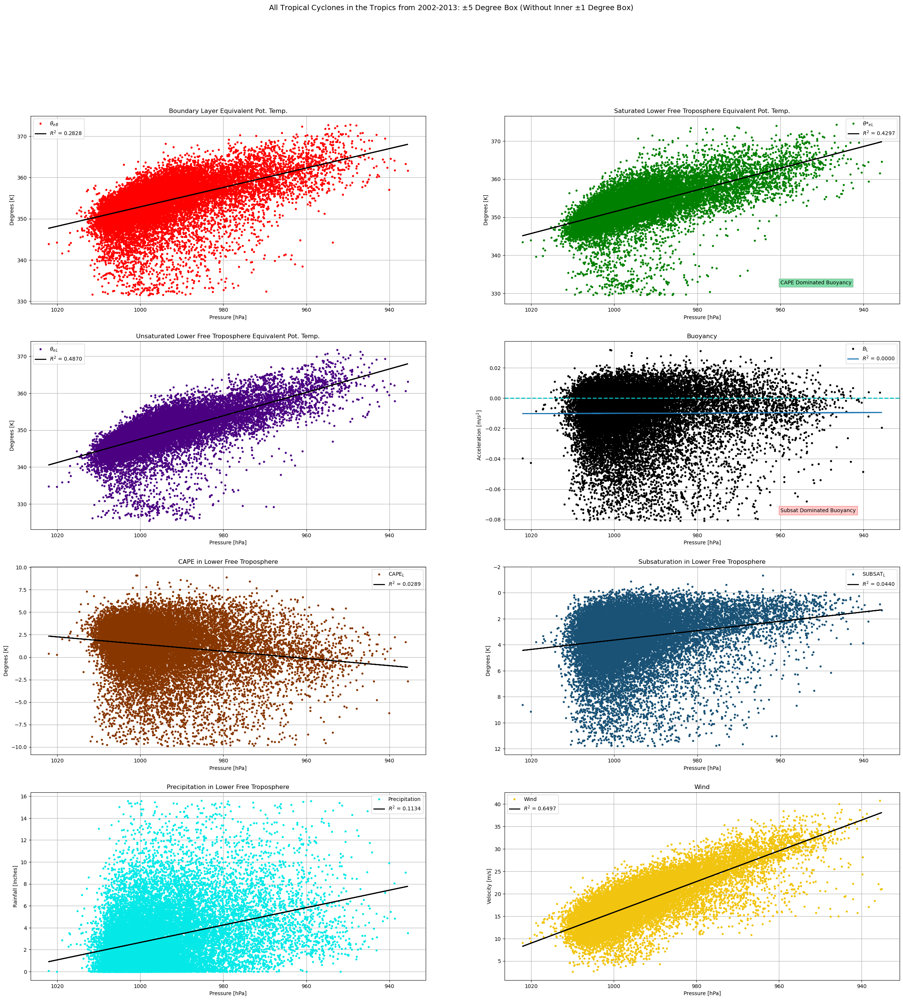

In [73]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_allin_EQBL,EQBL_allin, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_allin_EQBL,EQBl_allin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_allin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_allin_EQSLFT,EQSLFT_allin, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_allin_EQSLFT,EQSLFT_allin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_allin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_allin_EQULFT,EQULFT_allin, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_allin_EQULFT,EQULFT_allin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_allin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_allin_Buoy,Buoy_allin, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_allin_Buoy,Buoy_allin_fit[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_allin_rsq))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_allin_CAPE,CAPE_allin, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_allin_CAPE,CAPE_allin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_allin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_allin_Subsat,Subsat_allin, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_allin_Subsat,Subsat_allin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_allin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_allin_precip,precip_allin, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_allin_precip,precip_allin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_allin_rsq))

plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_allin,wind_allin, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_allin,wind_allin_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_allin_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('All Tropical Cyclones in the Tropics from 2002-2013: $\u00B1${} Degree Box (Without Inner $\u00B1${} Degree Box)'.format(offset,internal),fontsize=14);


# (Insert) Time Steps Ahead for Non-Landalling

/tmp/ipykernel_300559/1104616028.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


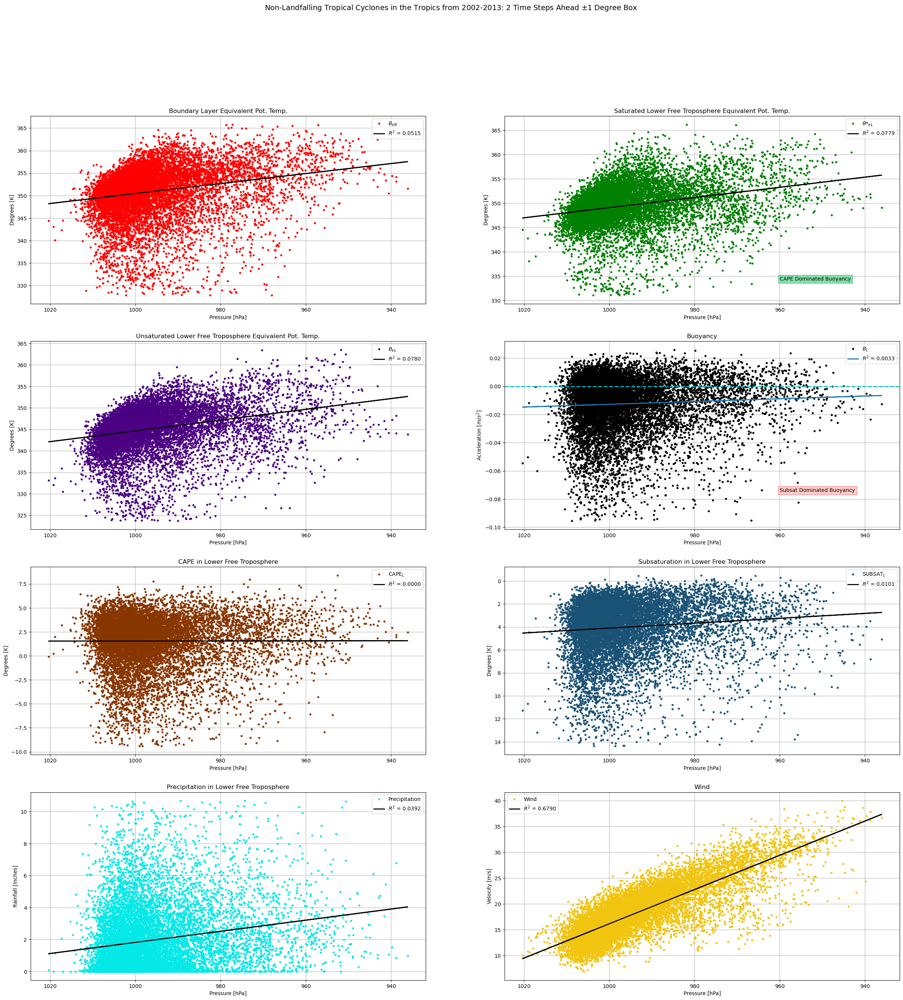

In [74]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_nlfpro_EQBL,EQBL_nlfpro, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_nlfpro_EQBL,EQBl_nlfpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_nlfpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_nlfpro_EQSLFT,EQSLFT_nlfpro, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_nlfpro_EQSLFT,EQSLFT_nlfpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_nlfpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_nlfpro_EQULFT,EQULFT_nlfpro, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_nlfpro_EQULFT,EQULFT_nlfpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_nlfpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_nlfpro_Buoy,Buoy_nlfpro, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_nlfpro_Buoy,Buoy_nlfpro_fit[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_nlfpro_rsq))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_nlfpro_CAPE,CAPE_nlfpro, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_nlfpro_CAPE,CAPE_nlfpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_nlfpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_nlfpro_Subsat,Subsat_nlfpro, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_nlfpro_Subsat,Subsat_nlfpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_nlfpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_nlfpro_precip,precip_nlfpro, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_nlfpro_precip,precip_nlfpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_nlfpro_rsq))

plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_nlfpro,wind_nlfpro, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_nlfpro,wind_nlfpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_nlfpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('Non-Landfalling Tropical Cyclones in the Tropics from 2002-2013: {} Time Steps Ahead $\u00B1${} Degree Box'.format(timeahead,internal),fontsize=14);


# (Insert) Time Steps Ahead for Landalling

/tmp/ipykernel_300559/89713449.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


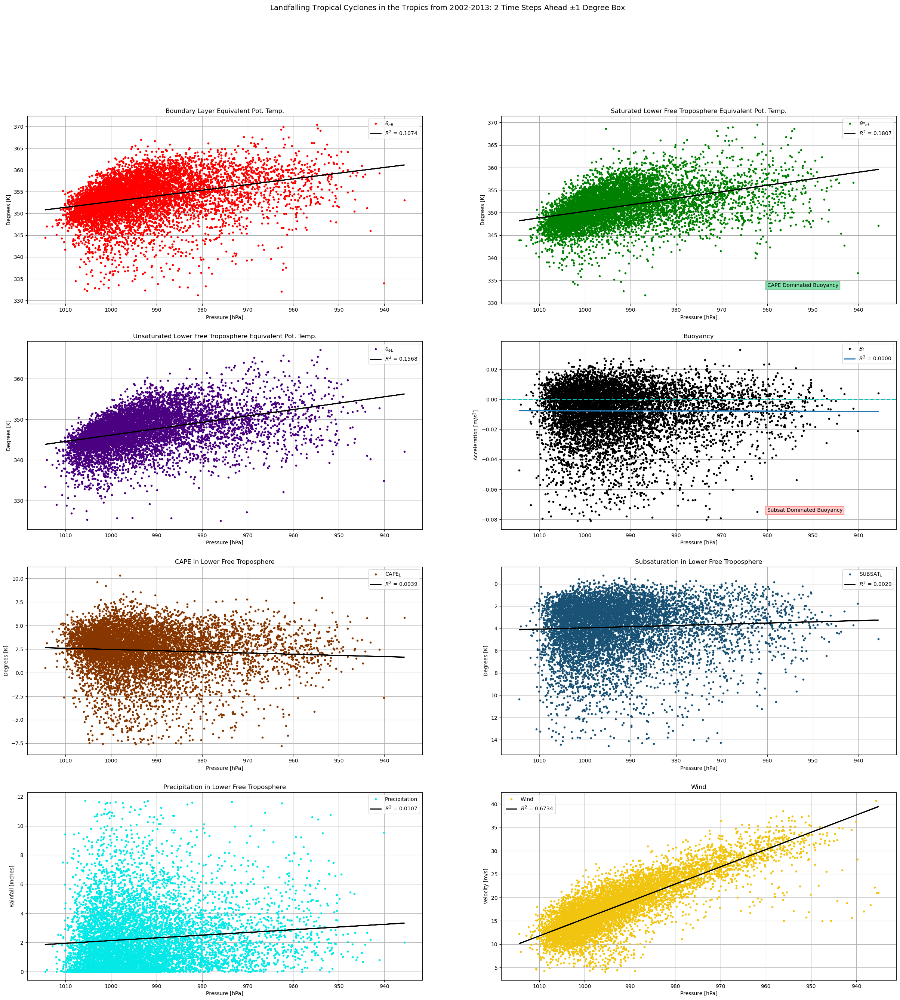

In [75]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_lfpro_EQBL,EQBL_lfpro, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_lfpro_EQBL,EQBl_lfpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_lfpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_lfpro_EQSLFT,EQSLFT_lfpro, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_lfpro_EQSLFT,EQSLFT_lfpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_lfpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_lfpro_EQULFT,EQULFT_lfpro, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_lfpro_EQULFT,EQULFT_lfpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_lfpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_lfpro_Buoy,Buoy_lfpro, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_lfpro_Buoy,Buoy_lfpro_fit[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_lfpro_rsq))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_lfpro_CAPE,CAPE_lfpro, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_lfpro_CAPE,CAPE_lfpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_lfpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_lfpro_Subsat,Subsat_lfpro, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_lfpro_Subsat,Subsat_lfpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_lfpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_lfpro_precip,precip_lfpro, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_lfpro_precip,precip_lfpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_lfpro_rsq))

plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_lfpro,wind_lfpro, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_lfpro,wind_lfpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_lfpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('Landfalling Tropical Cyclones in the Tropics from 2002-2013: {} Time Steps Ahead $\u00B1${} Degree Box'.format(timeahead,internal),fontsize=14);


# (Insert) Time Steps Ahead for All

/tmp/ipykernel_300559/1108122322.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,2,1) #For EQBL


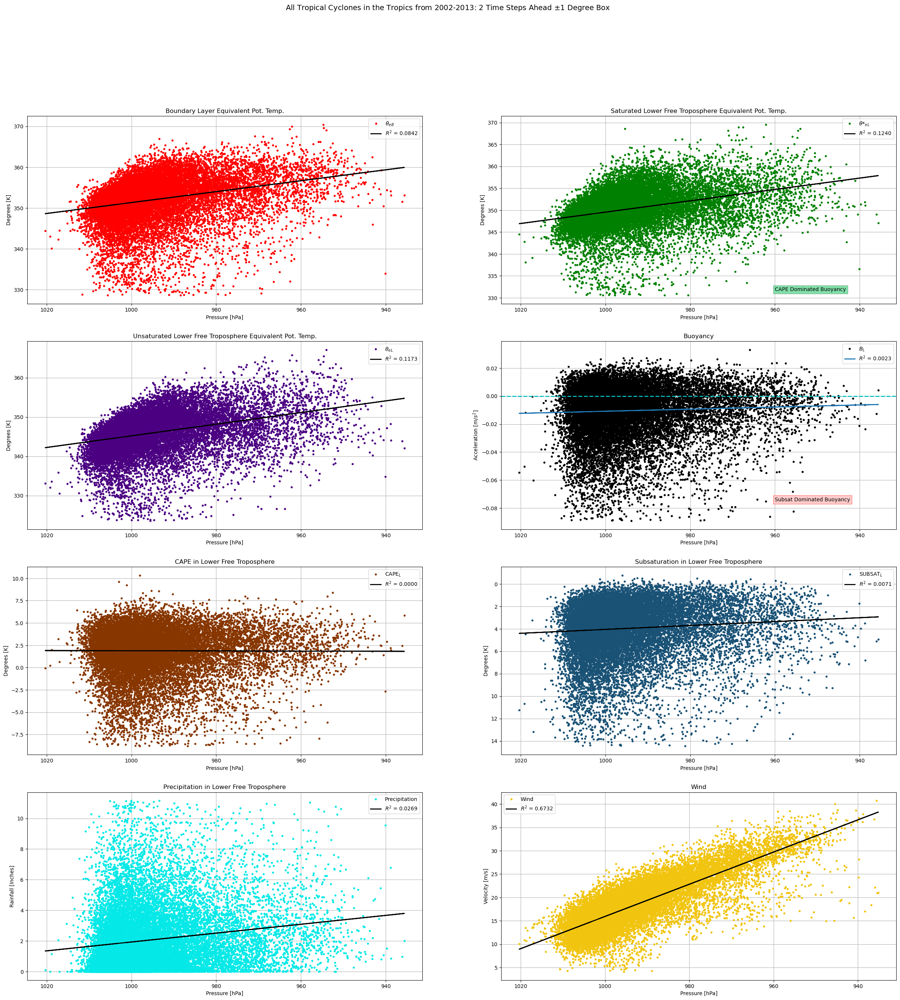

In [76]:
plt.subplots(figsize = (30,30))
plt.subplot(4,2,1) #For EQBL
plt.plot(psl_allpro_EQBL,EQBL_allpro, color='r', linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_B$")
plt.plot(psl_allpro_EQBL,EQBl_allpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQBl_allpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Boundary Layer Equivalent Pot. Temp.")
plt.subplot(4,2,2) #For EQSLFT
plt.plot(psl_allpro_EQSLFT,EQSLFT_allpro, color="g", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$*$_e$$_L$")
plt.plot(psl_allpro_EQSLFT,EQSLFT_allpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQSLFT_allpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis() 
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Saturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,3) #For EQULFT
plt.plot(psl_allpro_EQULFT,EQULFT_allpro, color="indigo", linestyle = "none", marker = 'o', markersize = 3, label = "$\\theta$$_e$$_L$")
plt.plot(psl_allpro_EQULFT,EQULFT_allpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(EQULFT_allpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Unsaturated Lower Free Troposphere Equivalent Pot. Temp.")
plt.subplot(4,2,4) #For Buoyancy
plt.plot(psl_allpro_Buoy,Buoy_allpro, color="k", linestyle = "none", marker = 'o', markersize = 3, label = "$B$$_L$")
plt.plot(psl_allpro_Buoy,Buoy_allpro_fit[1],linewidth=2, label = "$R^2$ = {:.4f}".format(Buoy_allpro_rsq))
plt.axhline(y=0, linestyle ="--", color="c",linewidth=2)
plt.text(960,.075, "CAPE Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec="#81B697",
                   fc="#82E0AA"))
plt.text(960,-.075, "Subsat Dominated Buoyancy", bbox=dict(boxstyle="square",
                   ec=(1., 0.5, 0.5),
                   fc=(1., 0.8, 0.8)))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.title("Buoyancy")
plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10)

plt.subplot(4,2,5) #For CAPE
plt.plot(psl_allpro_CAPE,CAPE_allpro, color='#873600', linestyle = "none", marker = 'o', markersize = 3, label = "CAPE$_L$")
plt.plot(psl_allpro_CAPE,CAPE_allpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(CAPE_allpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("CAPE in Lower Free Troposphere")

plt.subplot(4,2,6) #For Subsaturation
plt.plot(psl_allpro_Subsat,Subsat_allpro, color='#1A5276', linestyle = "none", marker = 'o', markersize = 3, label = "SUBSAT$_L$")
plt.plot(psl_allpro_Subsat,Subsat_allpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(Subsat_allpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Degrees [K]", fontsize = 10)
plt.title("Subsaturation in Lower Free Troposphere")

plt.subplot(4,2,7) #For Precipitation
plt.plot(psl_allpro_precip,precip_allpro, color="#04e9e7", linestyle = "none", marker = 'o', markersize = 3, label = "Precipitation")
plt.plot(psl_allpro_precip,precip_allpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(precip_allpro_rsq))

plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Rainfall [Inches]", fontsize = 10)
plt.title("Precipitation in Lower Free Troposphere")

plt.subplot(4,2,8) #For Wind
plt.plot(psl_allpro,wind_allpro, color='#F1C40F', linestyle = "none", marker = 'o', markersize = 3, label = "Wind")
plt.plot(psl_allpro,wind_allpro_fit[1],linewidth=2, color="k", label = "$R^2$ = {:.4f}".format(wind_allpro_rsq))
plt.grid()
plt.legend()
plt.gca().invert_xaxis()
plt.xlabel("Pressure [hPa]", fontsize = 10)
plt.ylabel("Velocity [m/s]", fontsize = 10)
plt.title("Wind")

plt.suptitle('All Tropical Cyclones in the Tropics from 2002-2013: {} Time Steps Ahead $\u00B1${} Degree Box'.format(timeahead,internal),fontsize=14);


In [26]:
variable="Subsaturation"

# Plot the Internal Bins with Variable Choice

/tmp/ipykernel_386263/1672279466.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2,2,1) #For NLF


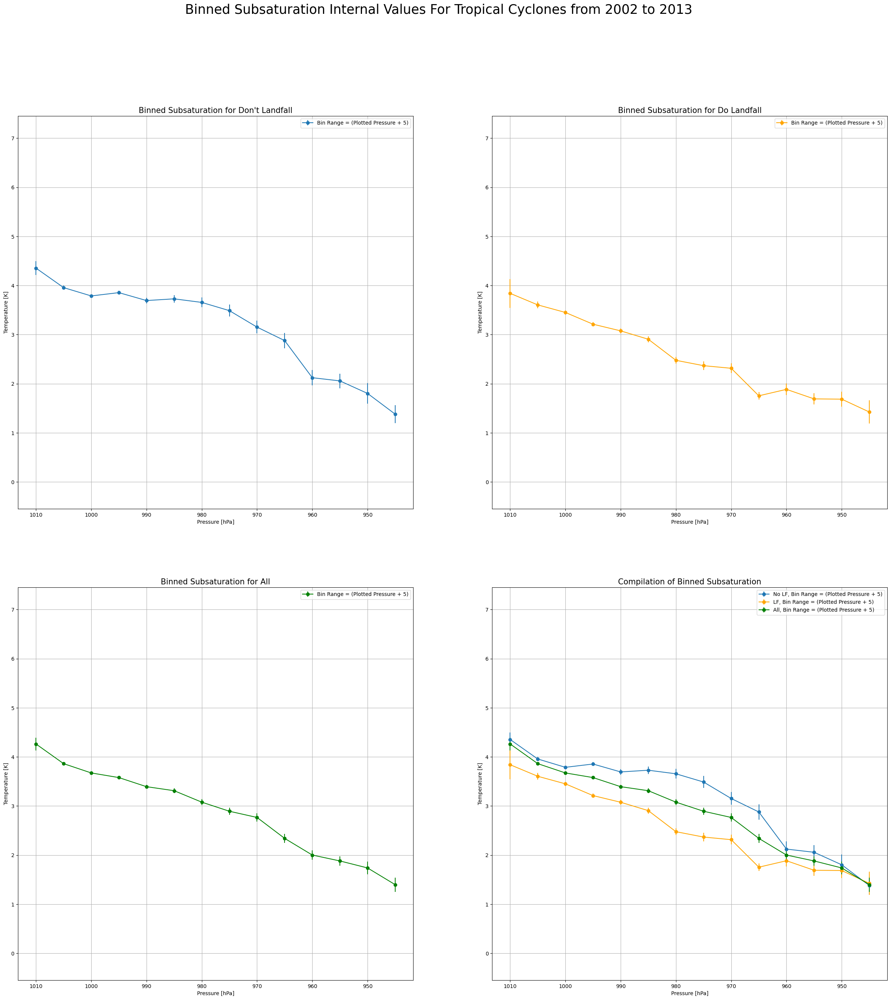

In [27]:
plt.subplots(figsize = (30,30))
plt.subplot(2,2,1) #For NLF
if variable == "EQBL":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfin_psl_means, nlfin_err,nlfin_his = bin_buoyancy(psl_nlfin_EQBL,EQBL_nlfin,buoy_bins) #take bins
    minn=np.average(EQBL_allin)-20
    maxx=np.average(EQBL_allin)+20
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfin_psl_means, nlfin_err,nlfin_his = bin_buoyancy(psl_nlfin_EQSLFT,EQSLFT_nlfin,buoy_bins) #take bins
    minn=np.average(EQSLFT_allin)-20
    maxx=np.average(EQSLFT_allin)+20
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfin_psl_means, nlfin_err,nlfin_his = bin_buoyancy(psl_nlfin_EQULFT,EQULFT_nlfin,buoy_bins) #take bins
    minn=np.average(EQULFT_allin)-20
    maxx=np.average(EQULFT_allin)+20
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)  
    nlfin_psl_means, nlfin_err,nlfin_his = bin_buoyancy(psl_nlfin_Subsat,Subsat_nlfin,buoy_bins) #take bins
    minn=np.average(Subsat_allin)-4
    maxx=np.average(Subsat_allin)+4
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfin_psl_means, nlfin_err,nlfin_his = bin_buoyancy(psl_nlfin_CAPE,CAPE_nlfin,buoy_bins) #take bins
    minn=np.average(CAPE_allin)-4
    maxx=np.average(CAPE_allin)+4
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfin_psl_means, nlfin_err,nlfin_his = bin_buoyancy(psl_nlfin_Buoy,Buoy_nlfin,buoy_bins) #take bins
    minn=np.average(Buoy_allin)-.05
    maxx=np.average(Buoy_allin)+.05
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfin_psl_means, nlfin_err,nlfin_his = bin_buoyancy(psl_nlfin_precip,precip_nlfin,buoy_bins) #take bins
    minn=np.average(precip_allin)-4
    maxx=np.average(precip_allin)+4
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10);   
    
    
plt.errorbar(buoy_bins,nlfin_psl_means,nlfin_err,color='#1f77b4',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))

plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
plt.title("Binned {} for Don't Landfall".format(variable),fontsize=15)


plt.subplot(2,2,2) #For LF
if variable == "EQBL":
    lfin_psl_means, lfin_err,lfin_his = bin_buoyancy(psl_lfin_EQBL,EQBL_lfin,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    lfin_psl_means, lfin_err, lfin_his = bin_buoyancy(psl_lfin_EQSLFT,EQSLFT_lfin,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    lfin_psl_means, lfin_err, lfin_his = bin_buoyancy(psl_lfin_EQULFT,EQULFT_lfin,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    lfin_psl_means, lfin_err, lfin_his = bin_buoyancy(psl_lfin_Subsat,Subsat_lfin,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    lfin_psl_means, lfin_err, lfin_his = bin_buoyancy(psl_lfin_CAPE,CAPE_lfin,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    lfin_psl_means, lfin_err, lfin_his = bin_buoyancy(psl_lfin_Buoy,Buoy_lfin,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    lfin_psl_means, lfin_err, lfin_his = bin_buoyancy(psl_lfin_precip,precip_lfin,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10); 
    
plt.errorbar(buoy_bins,lfin_psl_means,lfin_err,color='orange',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
plt.title("Binned {} for Do Landfall".format(variable),fontsize=15)


plt.subplot(2,2,3) #For all
if variable == "EQBL":
    allin_psl_means, allin_err,allin_his = bin_buoyancy(psl_allin_EQBL,EQBL_allin,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    allin_psl_means, allin_err,allin_his = bin_buoyancy(psl_allin_EQSLFT,EQSLFT_allin,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    allin_psl_means, allin_err, allin_his = bin_buoyancy(psl_allin_EQULFT,EQULFT_allin,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    allin_psl_means, allin_err, allin_his = bin_buoyancy(psl_allin_Subsat,Subsat_allin,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    allin_psl_means, allin_err, allin_his = bin_buoyancy(psl_allin_CAPE,CAPE_allin,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    allin_psl_means, allin_err, allin_his = bin_buoyancy(psl_allin_Buoy,Buoy_allin,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    allin_psl_means, allin_err, allin_his = bin_buoyancy(psl_allin_precip,precip_allin,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10); 

plt.errorbar(buoy_bins,allin_psl_means,allin_err,color='g',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()    
plt.title("Binned {} for All".format(variable),fontsize=15)


plt.subplot(2,2,4) #For all 3
plt.errorbar(buoy_bins,nlfin_psl_means,nlfin_err,color='#1f77b4',marker='o', label = "No LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,lfin_psl_means,lfin_err,color='orange',marker='o', label = "LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,allin_psl_means,allin_err,color='g',marker='o', label = "All, Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
if variable == "EQBL":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10);   
plt.title("Compilation of Binned {}".format(variable),fontsize=15)
plt.suptitle("Binned {} Internal Values For Tropical Cyclones from 2002 to 2013".format(variable), fontsize = 25);

# Plot the External Bins with Variable Choice

/tmp/ipykernel_386263/3449360929.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2,2,1) #For NLF


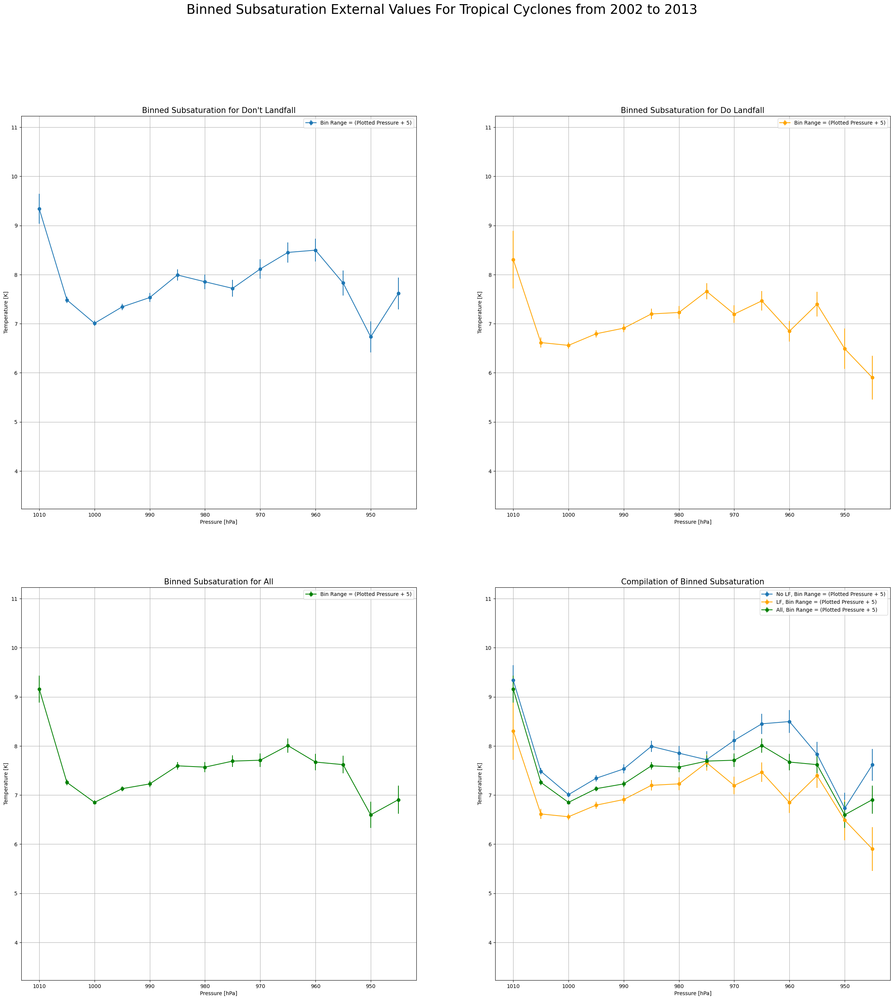

In [28]:
plt.subplots(figsize = (30,30))
plt.subplot(2,2,1) #For NLF
if variable == "EQBL":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfex_psl_means, nlfex_err,nlfex_his = bin_buoyancy(psl_nlfex_EQBL,EQBL_nlfex,buoy_bins) #take bins
    minn=np.average(EQBL_allex)-20
    maxx=np.average(EQBL_allex)+20
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfex_psl_means, nlfex_err,nlfex_his = bin_buoyancy(psl_nlfex_EQSLFT,EQSLFT_nlfex,buoy_bins) #take bins
    minn=np.average(EQSLFT_allex)-20
    maxx=np.average(EQSLFT_allex)+20
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfex_psl_means, nlfex_err,nlfex_his = bin_buoyancy(psl_nlfex_EQULFT,EQULFT_nlfex,buoy_bins) #take bins
    minn=np.average(EQULFT_allex)-4
    maxx=np.average(EQULFT_allex)+4
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)  
    nlfex_psl_means, nlfex_err,nlfex_his = bin_buoyancy(psl_nlfex_Subsat,Subsat_nlfex,buoy_bins) #take bins
    minn=np.average(Subsat_allex)-4
    maxx=np.average(Subsat_allex)+4
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfex_psl_means, nlfex_err,nlfex_his = bin_buoyancy(psl_nlfex_CAPE,CAPE_nlfex,buoy_bins) #take bins
    minn=np.average(CAPE_allex)-4
    maxx=np.average(CAPE_allex)+4
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfex_psl_means, nlfex_err,nlfex_his = bin_buoyancy(psl_nlfex_Buoy,Buoy_nlfex,buoy_bins) #take bins
    minn=np.average(Buoy_allex)-.05
    maxx=np.average(Buoy_allex)+.05
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfex_psl_means, nlfex_err,nlfex_his = bin_buoyancy(psl_nlfex_precip,precip_nlfex,buoy_bins) #take bins
    minn=np.average(precip_allex)-4
    maxx=np.average(precip_allex)+4
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10);   
    
    
plt.errorbar(buoy_bins,nlfex_psl_means,nlfex_err,color='#1f77b4',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))

plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
plt.title("Binned {} for Don't Landfall".format(variable),fontsize=15)


plt.subplot(2,2,2) #For LF
if variable == "EQBL":
    lfex_psl_means, lfex_err,lfex_his = bin_buoyancy(psl_lfex_EQBL,EQBL_lfex,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    lfex_psl_means, lfex_err, lfex_his = bin_buoyancy(psl_lfex_EQSLFT,EQSLFT_lfex,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    lfex_psl_means, lfex_err, lfex_his = bin_buoyancy(psl_lfex_EQULFT,EQULFT_lfex,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    lfex_psl_means, lfex_err, lfex_his = bin_buoyancy(psl_lfex_Subsat,Subsat_lfex,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    lfex_psl_means, lfex_err, lfex_his = bin_buoyancy(psl_lfex_CAPE,CAPE_lfex,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    lfex_psl_means, lfex_err, lfex_his = bin_buoyancy(psl_lfex_Buoy,Buoy_lfex,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    lfex_psl_means, lfex_err, lfex_his = bin_buoyancy(psl_lfex_precip,precip_lfex,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10); 
    
plt.errorbar(buoy_bins,lfex_psl_means,lfex_err,color='orange',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
plt.title("Binned {} for Do Landfall".format(variable),fontsize=15)


plt.subplot(2,2,3) #For all
if variable == "EQBL":
    allex_psl_means, allex_err,allex_his = bin_buoyancy(psl_allex_EQBL,EQBL_allex,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    allex_psl_means, allex_err,allex_his = bin_buoyancy(psl_allex_EQSLFT,EQSLFT_allex,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    allex_psl_means, allex_err, allex_his = bin_buoyancy(psl_allex_EQULFT,EQULFT_allex,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    allex_psl_means, allex_err, allex_his = bin_buoyancy(psl_allex_Subsat,Subsat_allex,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    allex_psl_means, allex_err, allex_his = bin_buoyancy(psl_allex_CAPE,CAPE_allex,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    allex_psl_means, allex_err, allex_his = bin_buoyancy(psl_allex_Buoy,Buoy_allex,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    allex_psl_means, allex_err, allex_his = bin_buoyancy(psl_allex_precip,precip_allex,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10); 

plt.errorbar(buoy_bins,allex_psl_means,allex_err,color='g',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()    
plt.title("Binned {} for All".format(variable),fontsize=15)


plt.subplot(2,2,4) #For all 3
plt.errorbar(buoy_bins,nlfex_psl_means,nlfex_err,color='#1f77b4',marker='o', label = "No LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,lfex_psl_means,lfex_err,color='orange',marker='o', label = "LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,allex_psl_means,allex_err,color='g',marker='o', label = "All, Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
if variable == "EQBL":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10);   
plt.title("Compilation of Binned {}".format(variable),fontsize=15)
plt.suptitle("Binned {} External Values For Tropical Cyclones from 2002 to 2013".format(variable), fontsize = 25);

# Plot the (Insert) Timesteps Ahead Bins with Variable Choice

/tmp/ipykernel_300559/1006274827.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2,2,1) #For NLF


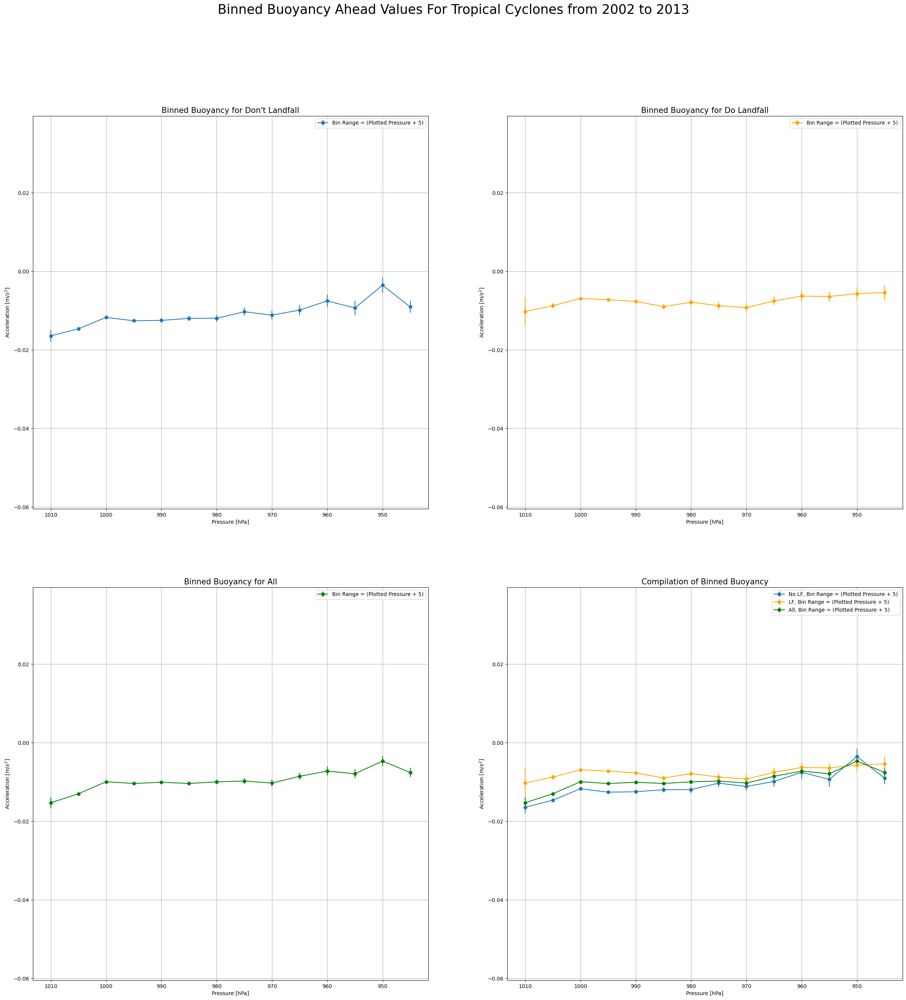

In [241]:
plt.subplots(figsize = (30,30))
plt.subplot(2,2,1) #For NLF
if variable == "EQBL":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfpro_psl_means, nlfpro_err,nlfpro_his = bin_buoyancy(psl_nlfpro_EQBL,EQBL_nlfpro,buoy_bins) #take bins
    minn=np.average(EQBL_allpro)-20
    maxx=np.average(EQBL_allpro)+20
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfpro_psl_means, nlfpro_err,nlfpro_his = bin_buoyancy(psl_nlfpro_EQSLFT,EQSLFT_nlfpro,buoy_bins) #take bins
    minn=np.average(EQSLFT_allpro)-20
    maxx=np.average(EQSLFT_allpro)+20
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfpro_psl_means, nlfpro_err,nlfpro_his = bin_buoyancy(psl_nlfpro_EQULFT,EQULFT_nlfpro,buoy_bins) #take bins
    minn=np.average(EQULFT_allpro)-20
    maxx=np.average(EQULFT_allpro)+20
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)  
    nlfpro_psl_means, nlfpro_err,nlfpro_his = bin_buoyancy(psl_nlfpro_Subsat,Subsat_nlfpro,buoy_bins) #take bins
    minn=np.average(Subsat_allpro)-4
    maxx=np.average(Subsat_allpro)+4
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfpro_psl_means, nlfpro_err,nlfpro_his = bin_buoyancy(psl_nlfpro_CAPE,CAPE_nlfpro,buoy_bins) #take bins
    minn=np.average(CAPE_allpro)-4
    maxx=np.average(CAPE_allpro)+4
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfpro_psl_means, nlfpro_err,nlfpro_his = bin_buoyancy(psl_nlfpro_Buoy,Buoy_nlfpro,buoy_bins) #take bins
    minn=np.average(Buoy_allpro)-.05
    maxx=np.average(Buoy_allpro)+.05
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    ches=5
    buoy_bins=np.arange(start,stop,spacing)
    nlfpro_psl_means, nlfpro_err,nlfpro_his = bin_buoyancy(psl_nlfpro_precip,precip_nlfpro,buoy_bins) #take bins
    minn=np.average(precip_allpro)-2
    maxx=np.average(precip_allpro)+2
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10);   
    
    
plt.errorbar(buoy_bins,nlfpro_psl_means,nlfpro_err,color='#1f77b4',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))

plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
plt.title("Binned {} for Don't Landfall".format(variable),fontsize=15)


plt.subplot(2,2,2) #For LF
if variable == "EQBL":
    lfpro_psl_means, lfpro_err,lfpro_his = bin_buoyancy(psl_lfpro_EQBL,EQBL_lfpro,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    lfpro_psl_means, lfpro_err, lfpro_his = bin_buoyancy(psl_lfpro_EQSLFT,EQSLFT_lfpro,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    lfpro_psl_means, lfpro_err, lfpro_his = bin_buoyancy(psl_lfpro_EQULFT,EQULFT_lfpro,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    lfpro_psl_means, lfpro_err, lfpro_his = bin_buoyancy(psl_lfpro_Subsat,Subsat_lfpro,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    lfpro_psl_means, lfpro_err, lfpro_his = bin_buoyancy(psl_lfpro_CAPE,CAPE_lfpro,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    lfpro_psl_means, lfpro_err, lfpro_his = bin_buoyancy(psl_lfpro_Buoy,Buoy_lfpro,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    lfpro_psl_means, lfpro_err, lfpro_his = bin_buoyancy(psl_lfpro_precip,precip_lfpro,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10); 
    
plt.errorbar(buoy_bins,lfpro_psl_means,lfpro_err,color='orange',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
plt.title("Binned {} for Do Landfall".format(variable),fontsize=15)


plt.subplot(2,2,3) #For all
if variable == "EQBL":
    allpro_psl_means, allpro_err,allpro_his = bin_buoyancy(psl_allpro_EQBL,EQBL_allpro,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    allpro_psl_means, allpro_err,allpro_his = bin_buoyancy(psl_allpro_EQSLFT,EQSLFT_allpro,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    allpro_psl_means, allpro_err, allpro_his = bin_buoyancy(psl_allpro_EQULFT,EQULFT_allpro,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    allpro_psl_means, allpro_err, allpro_his = bin_buoyancy(psl_allpro_Subsat,Subsat_allpro,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    allpro_psl_means, allpro_err, allpro_his = bin_buoyancy(psl_allpro_CAPE,CAPE_allpro,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    allpro_psl_means, allpro_err, allpro_his = bin_buoyancy(psl_allpro_Buoy,Buoy_allpro,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    allpro_psl_means, allpro_err, allpro_his = bin_buoyancy(psl_allpro_precip,precip_allpro,buoy_bins) #take bins
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10); 

plt.errorbar(buoy_bins,allpro_psl_means,allpro_err,color='g',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()    
plt.title("Binned {} for All".format(variable),fontsize=15)


plt.subplot(2,2,4) #For all 3
plt.errorbar(buoy_bins,nlfpro_psl_means,nlfpro_err,color='#1f77b4',marker='o', label = "No LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,lfpro_psl_means,lfpro_err,color='orange',marker='o', label = "LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,allpro_psl_means,allpro_err,color='g',marker='o', label = "All, Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
plt.gca().invert_xaxis()
if variable == "EQBL":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQSLFT":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "EQULFT":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Subsaturation":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Acceleration [m/$s^2$]", fontsize = 10);
elif variable == "Precipitation":
    plt.xlabel("Pressure [hPa]", fontsize = 10)
    plt.ylabel("Rainfall [In]", fontsize = 10);   
plt.title("Compilation of Binned {}".format(variable),fontsize=15)
plt.suptitle("Binned {} Ahead Values For Tropical Cyclones from 2002 to 2013".format(variable), fontsize = 25);

# Plot the Internal Precipitation Bin with CAPE/Subsaturation/Buoyancy

/tmp/ipykernel_300559/3223237302.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2,2,1) #For NLF


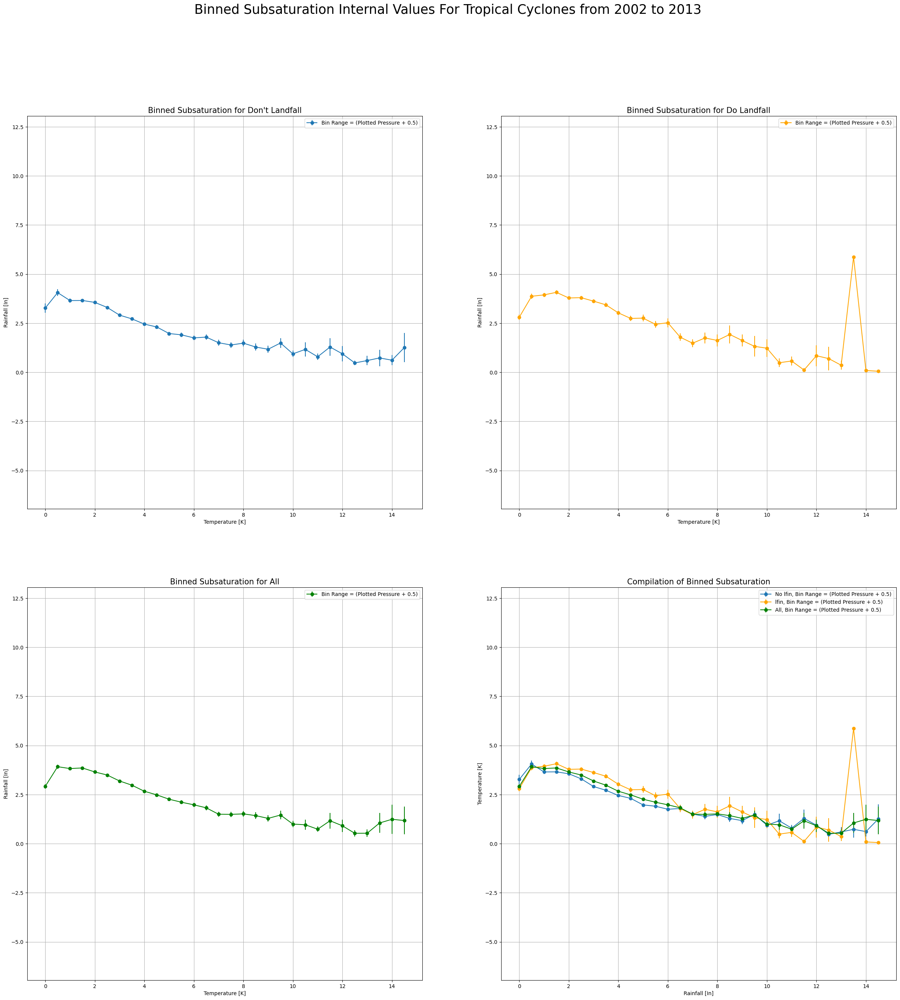

In [231]:
plt.subplots(figsize = (30,30))
plt.subplot(2,2,1) #For NLF
if variable == "Subsaturation":
    ches=.5
    buoy_bins=np.arange(0,15,.5)  
    nlfin_psl_means, nlfin_err,nlfin_his = bin_buoyancy(precip_nlfin_Subsat,precip_Subsat_nlfin,buoy_bins) #take bins
    minn=np.average(precip_allin)-10
    maxx=np.average(precip_allin)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    ches=.5
    buoy_bins=np.arange(-7.5,7.5,.5)  
    nlfin_psl_means, nlfin_err,nlfin_his = bin_buoyancy(precip_nlfin_CAPE,precip_CAPE_nlfin,buoy_bins) #take bins
    minn=np.average(precip_allin)-10
    maxx=np.average(precip_allin)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    ches=.01
    buoy_bins=np.arange(-0.2,.15,0.01)
    nlfin_psl_means, nlfin_err,nlfin_his = bin_buoyancy(precip_nlfin_Buoy,precip_Buoy_nlfin,buoy_bins) #take bins
    minn=np.average(precip_allin)-10
    maxx=np.average(precip_allin)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
    
    
plt.errorbar(buoy_bins,nlfin_psl_means,nlfin_err,color='#1f77b4',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))

plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()
plt.title("Binned {} for Don't Landfall".format(variable),fontsize=15)


plt.subplot(2,2,2) #For LF
if variable == "Subsaturation":
    lfin_psl_means, lfin_err, lfin_his = bin_buoyancy(precip_lfin_Subsat,precip_Subsat_lfin,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    lfin_psl_means, lfin_err, lfin_his = bin_buoyancy(precip_lfin_CAPE,precip_CAPE_lfin,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    lfin_psl_means, lfin_err, lfin_his = bin_buoyancy(precip_lfin_Buoy,precip_Buoy_lfin,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
    
plt.errorbar(buoy_bins,lfin_psl_means,lfin_err,color='orange',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()
plt.title("Binned {} for Do Landfall".format(variable),fontsize=15)


plt.subplot(2,2,3) #For All

if variable == "Subsaturation":
    allin_psl_means, allin_err, allin_his = bin_buoyancy(precip_allin_Subsat,precip_Subsat_allin,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    allin_psl_means, allin_err, allin_his = bin_buoyancy(precip_allin_CAPE,precip_CAPE_allin,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    allin_psl_means, allin_err, allin_his = bin_buoyancy(precip_allin_Buoy,precip_Buoy_allin,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);

plt.errorbar(buoy_bins,allin_psl_means,allin_err,color='g',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()    
plt.title("Binned {} for All".format(variable),fontsize=15)


plt.subplot(2,2,4) #For all 3
plt.errorbar(buoy_bins,nlfin_psl_means,nlfin_err,color='#1f77b4',marker='o', label = "No lfin, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,lfin_psl_means,lfin_err,color='orange',marker='o', label = "lfin, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,allin_psl_means,allin_err,color='g',marker='o', label = "All, Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()

if variable == "Subsaturation":
    plt.xlabel("Rainfall [In]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    plt.xlabel("Rainfall [In]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
    
plt.title("Compilation of Binned {}".format(variable),fontsize=15)
plt.suptitle("Binned {} Internal Values For Tropical Cyclones from 2002 to 2013".format(variable), fontsize = 25);

# Plot the External Precipitation Bin with CAPE/Subsaturation/Buoyancy

/tmp/ipykernel_300559/3305344742.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2,2,1) #For NLF


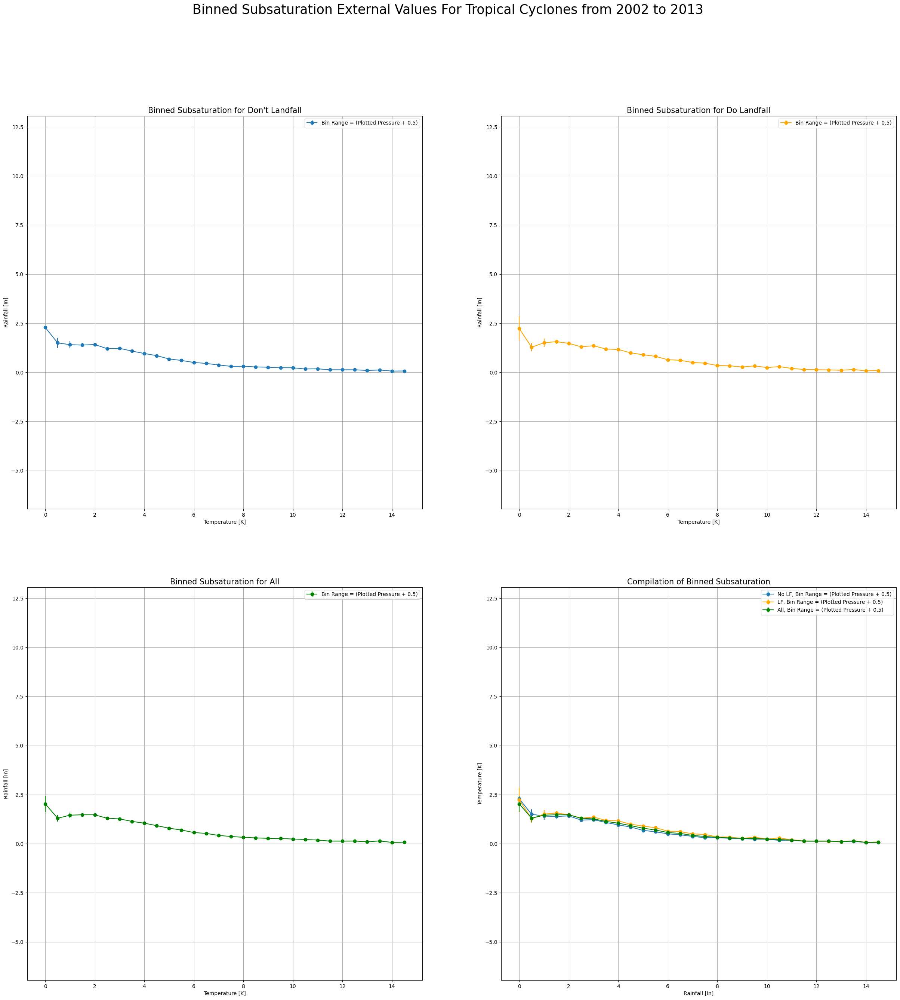

In [232]:
plt.subplots(figsize = (30,30))
plt.subplot(2,2,1) #For NLF
if variable == "Subsaturation":
    ches=.5
    buoy_bins=np.arange(0,15,.5)  
    nlfex_psl_means, nlfex_err,nlfex_his = bin_buoyancy(precip_nlfex_Subsat,precip_Subsat_nlfex,buoy_bins) #take bins
    minn=np.average(precip_allin)-10
    maxx=np.average(precip_allin)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    ches=.5
    buoy_bins=np.arange(-7.5,7.5,.5)  
    nlfex_psl_means, nlfex_err,nlfex_his = bin_buoyancy(precip_nlfex_CAPE,precip_CAPE_nlfex,buoy_bins) #take bins
    minn=np.average(precip_allin)-10
    maxx=np.average(precip_allin)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    ches=.01
    buoy_bins=np.arange(-0.2,.15,0.01)
    nlfex_psl_means, nlfex_err,nlfex_his = bin_buoyancy(precip_nlfex_Buoy,precip_Buoy_nlfex,buoy_bins) #take bins
    minn=np.average(precip_allin)-10
    maxx=np.average(precip_allin)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
    
    
plt.errorbar(buoy_bins,nlfex_psl_means,nlfex_err,color='#1f77b4',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))

plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()
plt.title("Binned {} for Don't Landfall".format(variable),fontsize=15)


plt.subplot(2,2,2) #For LF
if variable == "Subsaturation":
    lfex_psl_means, lfex_err, lfex_his = bin_buoyancy(precip_lfex_Subsat,precip_Subsat_lfex,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    lfex_psl_means, lfex_err, lfex_his = bin_buoyancy(precip_lfex_CAPE,precip_CAPE_lfex,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    lfex_psl_means, lfex_err, lfex_his = bin_buoyancy(precip_lfex_Buoy,precip_Buoy_lfex,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
    
plt.errorbar(buoy_bins,lfex_psl_means,lfex_err,color='orange',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()
plt.title("Binned {} for Do Landfall".format(variable),fontsize=15)


plt.subplot(2,2,3) #For All

if variable == "Subsaturation":
    allex_psl_means, allex_err, allex_his = bin_buoyancy(precip_allex_Subsat,precip_Subsat_allex,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    allex_psl_means, allex_err, allex_his = bin_buoyancy(precip_allex_CAPE,precip_CAPE_allex,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    allex_psl_means, allex_err, allex_his = bin_buoyancy(precip_allex_Buoy,precip_Buoy_allex,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);

plt.errorbar(buoy_bins,allex_psl_means,allex_err,color='g',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()    
plt.title("Binned {} for All".format(variable),fontsize=15)


plt.subplot(2,2,4) #For all 3
plt.errorbar(buoy_bins,nlfex_psl_means,nlfex_err,color='#1f77b4',marker='o', label = "No LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,lfex_psl_means,lfex_err,color='orange',marker='o', label = "LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,allex_psl_means,allex_err,color='g',marker='o', label = "All, Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()

if variable == "Subsaturation":
    plt.xlabel("Rainfall [In]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    plt.xlabel("Rainfall [In]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
    
plt.title("Compilation of Binned {}".format(variable),fontsize=15)
plt.suptitle("Binned {} External Values For Tropical Cyclones from 2002 to 2013".format(variable), fontsize = 25);

# Plot the (Insert) Time Steps Precipitation Bin with CAPE/Subsaturation/Buoyancy

/tmp/ipykernel_300559/2562681556.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2,2,1) #For NLF


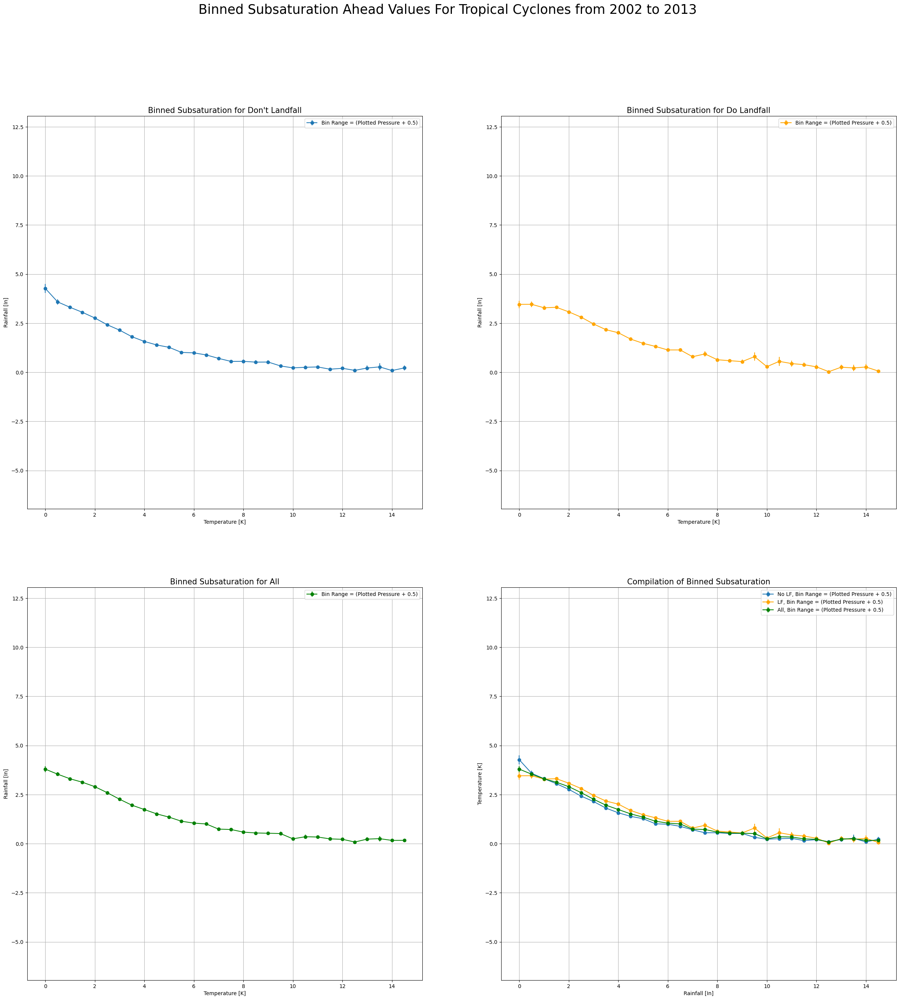

In [233]:
plt.subplots(figsize = (30,30))
plt.subplot(2,2,1) #For NLF
if variable == "Subsaturation":
    ches=.5
    buoy_bins=np.arange(0,15,.5)  
    nlfpro_psl_means, nlfpro_err,nlfpro_his = bin_buoyancy(precip_nlfpro_Subsat,precip_Subsat_nlfpro,buoy_bins) #take bins
    minn=np.average(precip_allin)-10
    maxx=np.average(precip_allin)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    ches=.5
    buoy_bins=np.arange(-7.5,7.5,.5)  
    nlfpro_psl_means, nlfpro_err,nlfpro_his = bin_buoyancy(precip_nlfpro_CAPE,precip_CAPE_nlfpro,buoy_bins) #take bins
    minn=np.average(precip_allin)-10
    maxx=np.average(precip_allin)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    ches=.01
    buoy_bins=np.arange(-0.2,.15,0.01)
    nlfpro_psl_means, nlfpro_err,nlfpro_his = bin_buoyancy(precip_nlfpro_Buoy,precip_Buoy_nlfpro,buoy_bins) #take bins
    minn=np.average(precip_allin)-10
    maxx=np.average(precip_allin)+10
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
    
    
plt.errorbar(buoy_bins,nlfpro_psl_means,nlfpro_err,color='#1f77b4',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))

plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()
plt.title("Binned {} for Don't Landfall".format(variable),fontsize=15)


plt.subplot(2,2,2) #For LF
if variable == "Subsaturation":
    lfpro_psl_means, lfpro_err, lfpro_his = bin_buoyancy(precip_lfpro_Subsat,precip_Subsat_lfpro,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    lfpro_psl_means, lfpro_err, lfpro_his = bin_buoyancy(precip_lfpro_CAPE,precip_CAPE_lfpro,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    lfpro_psl_means, lfpro_err, lfpro_his = bin_buoyancy(precip_lfpro_Buoy,precip_Buoy_lfpro,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
    
plt.errorbar(buoy_bins,lfpro_psl_means,lfpro_err,color='orange',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()
plt.title("Binned {} for Do Landfall".format(variable),fontsize=15)


plt.subplot(2,2,3) #For All

if variable == "Subsaturation":
    allpro_psl_means, allpro_err, allpro_his = bin_buoyancy(precip_allpro_Subsat,precip_Subsat_allpro,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    allpro_psl_means, allpro_err, allpro_his = bin_buoyancy(precip_allpro_CAPE,precip_CAPE_allpro,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    allpro_psl_means, allpro_err, allpro_his = bin_buoyancy(precip_allpro_Buoy,precip_Buoy_allpro,buoy_bins) #take bins
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);

plt.errorbar(buoy_bins,allpro_psl_means,allpro_err,color='g',marker='o', label = "Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()    
plt.title("Binned {} for All".format(variable),fontsize=15)


plt.subplot(2,2,4) #For all 3
plt.errorbar(buoy_bins,nlfpro_psl_means,nlfpro_err,color='#1f77b4',marker='o', label = "No LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,lfpro_psl_means,lfpro_err,color='orange',marker='o', label = "LF, Bin Range = (Plotted Pressure + {})".format(ches))
plt.errorbar(buoy_bins,allpro_psl_means,allpro_err,color='g',marker='o', label = "All, Bin Range = (Plotted Pressure + {})".format(ches))
plt.grid()
plt.ylim(minn,maxx)
plt.legend()
#plt.gca().invert_xaxis()

if variable == "Subsaturation":
    plt.xlabel("Rainfall [In]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "CAPE":
    plt.xlabel("Rainfall [In]", fontsize = 10)
    plt.ylabel("Temperature [K]", fontsize = 10);
elif variable == "Buoyancy":
    plt.ylabel("Rainfall [In]", fontsize = 10)
    plt.xlabel("Acceleration [m/$s^2$]", fontsize = 10);
    
plt.title("Compilation of Binned {}".format(variable),fontsize=15)
plt.suptitle("Binned {} Ahead Values For Tropical Cyclones from 2002 to 2013".format(variable), fontsize = 25);